# TCR analysis (on the all-cells object, though only subsetting to T cells)

because there is no separate T cell manifold

CVID, revisions

analysis with scirpy

In [2]:
import scirpy as ir # requires 'pip install scirpy'
import scanpy as sc
from glob import glob
import pandas as pd
import numpy as np
import tarfile
import anndata
import warnings
from numba import NumbaPerformanceWarning
import matplotlib.pyplot as plt

# ignore numba performance warnings
warnings.filterwarnings("ignore", category=NumbaPerformanceWarning)

In [3]:
sc.settings.set_figure_params(dpi=100)


In [4]:
%%bash

pip freeze

aiohttp==3.6.2
airr==1.3.1
alembic==1.3.0
anndata==0.7.5
annoy==1.16.2
async-generator==1.10
async-timeout==3.0.1
attrs==19.3.0
backcall==0.1.0
bbknn==1.3.6
bleach==3.1.0
blinker==1.4
certifi==2019.9.11
certipy==0.1.3
cffi==1.13.2
chardet==3.0.4
Click==7.0
conda==4.7.12
conda-package-handling==1.6.0
cryptography==2.8
cycler==0.10.0
Cython==0.29.14
decorator==4.4.1
defusedxml==0.6.0
entrypoints==0.3
fbpca==1.0
geosketch==1.0
get-version==2.1
h5py==2.10.0
idna==2.8
importlib-metadata==0.23
intervaltree==2.1.0
ipykernel==5.1.3
ipython==7.9.0
ipython-genutils==0.2.0
jedi==0.15.1
Jinja2==2.10.3
joblib==0.14.0
json5==0.8.5
jsonschema==3.1.1
jupyter-client==5.3.3
jupyter-core==4.5.0
jupyter-rsession-proxy==1.0b6
jupyter-server-proxy==1.2.0
jupyterhub==1.0.0
jupyterlab==1.2.1
jupyterlab-server==1.0.6
kiwisolver==1.1.0
legacy-api-wrap==1.2
leidenalg==0.7.0
llvmlite==0.30.0
loompy==3.0.6
louvain==0.6.1
Mako==1.1.0
MarkupSafe==1.1.1
matplotlib==3.3.3
mistune==0.8.4
more-itertools==7.2.0
multidict

## Reading in the main transcriptomics object

In [5]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/'

In [33]:
# object with all cells, norm., log tr and scaled gex counts in .X, norm. and log tr. gex counts in .raw.X, HVG-subsetted
adata = sc.read(save_path+'adata_hvg_bbknn_by_sample_nodoublets_20_PCs_GEX_and_SoupX_denoised_protein_all_samples_cleaned_up_final_20210111.h5ad')

In [34]:
# getting final annotation table:
annot_table = pd.read_csv(save_path + 'annotation_of_adata_hvg_BBKNN_GEX_and_SoupX_denoised_protein_all_samples_20210108.csv',
                         index_col=0)
annot_table

,cell_type_final
AAACCTGAGAATGTGT-1,Monocytes_CD16+
AAACCTGAGACTAAGT-1,cDC2
AAACCTGAGCCGCCTA-1,TCM_CD8+
AAACCTGAGCGCCTCA-1,TEM_CD8+
AAACCTGAGGATGTAT-1,TEM_CD8+
...,...
TTTGTCATCGCCTGAG-1,doublets_by_TCR
TTTGTCATCGTCACGG-1-1,Monocytes_Classical
TTTGTCATCGTCTGCT-1-1,iNKT_cells
TTTGTCATCTACTTAC-1,doublets


In [35]:
adata.obs['cell_type_final'] = annot_table.loc[adata.obs_names,'cell_type_final']

In [36]:
np.unique(adata.obs['cell_type_final'])

array(['B_cells_memory', 'B_cells_naive', 'MAIT_cells', 'Macrophages',
       'Monocytes_CD16+', 'Monocytes_Classical', 'NK_CD16_bright',
       'NK_CD56_bright', 'Plasma_cells', 'Precursor_Cells', 'TCM_CD8+',
       'TEM_CD8+', 'TMRA_CD8+', 'T_cells_CD4+_activated',
       'T_cells_CD4+_memory', 'T_cells_CD4+_naive',
       'T_cells_CD8+_activated', 'T_cells_CD8+_naive', 'cDC1', 'cDC2',
       'gdT_cells', 'iNKT_cells', 'pDCs'], dtype=object)

### Loading data from cellranger output

#### general scRNA-seq

35008_CV005_RV9039258      unstim    

35008_CV005_RV9039259      unstim   

35008_CV005_RV9039260      CD40L

35008_CV005_RV9039261      CD40L    

35008_CV005_RV9039262      CD3    

35008_CV005_RV9039263      CD3    

35008_CV005_RV9039264      BCR

35008_CV005_RV9039265      BCR

35171_CV005_RV9039361      unstim

35171_CV005_RV9039362      CD40L

35171_CV005_RV9039363      CD3

35171_CV005_RV9039364      BCR

#### TCR enriched

35008_CV005_RV9039266      unstim

35008_CV005_RV9039267      unstim

35008_CV005_RV9039268      CD40L

35008_CV005_RV9039269      CD40L

35008_CV005_RV9039270      CD3

35008_CV005_RV9039271      CD3

35008_CV005_RV9039272      BCR

35008_CV005_RV9039273      BCR

35171_CV005_RV9039368      unstim

35171_CV005_RV9039369      CD40L

35171_CV005_RV9039370      CD3
 
35171_CV005_RV9039371      BCR


In [37]:
samples_enriched = ['35008_CV005_RV9039266',
                    '35008_CV005_RV9039267',
                    '35008_CV005_RV9039268',
                    '35008_CV005_RV9039269',
                    '35008_CV005_RV9039270',
                    '35008_CV005_RV9039271',
                    '35008_CV005_RV9039272',
                    '35008_CV005_RV9039273',
                   '35171_CV005_RV9039368',
                   '35171_CV005_RV9039369',
                   '35171_CV005_RV9039370',
                   '35171_CV005_RV9039371']

In [38]:
np.unique(adata.obs['sample'])

array(['35008_CV005_RV9039258_and_35008_CV005_RV9039282',
       '35008_CV005_RV9039259_and_35008_CV005_RV9039283',
       '35008_CV005_RV9039260_and_35008_CV005_RV9039284',
       '35008_CV005_RV9039261_and_35008_CV005_RV9039285',
       '35008_CV005_RV9039262_and_35008_CV005_RV9039286',
       '35008_CV005_RV9039263_and_35008_CV005_RV9039287',
       '35008_CV005_RV9039264_and_35008_CV005_RV9039288',
       '35008_CV005_RV9039265_and_35008_CV005_RV9039289',
       '35171_CV005_RV9039361', '35171_CV005_RV9039362',
       '35171_CV005_RV9039363', '35171_CV005_RV9039364'], dtype=object)

In [39]:
dict_samples_enrich_to_general =  {}

# BCR

dict_samples_enrich_to_general['35008_CV005_RV9039266'] = '35008_CV005_RV9039258_and_35008_CV005_RV9039282'
dict_samples_enrich_to_general['35008_CV005_RV9039267'] = '35008_CV005_RV9039259_and_35008_CV005_RV9039283'
dict_samples_enrich_to_general['35008_CV005_RV9039268'] = '35008_CV005_RV9039260_and_35008_CV005_RV9039284'
dict_samples_enrich_to_general['35008_CV005_RV9039269'] = '35008_CV005_RV9039261_and_35008_CV005_RV9039285'
dict_samples_enrich_to_general['35008_CV005_RV9039270'] = '35008_CV005_RV9039262_and_35008_CV005_RV9039286'
dict_samples_enrich_to_general['35008_CV005_RV9039271'] = '35008_CV005_RV9039263_and_35008_CV005_RV9039287'
dict_samples_enrich_to_general['35008_CV005_RV9039272'] = '35008_CV005_RV9039264_and_35008_CV005_RV9039288'
dict_samples_enrich_to_general['35008_CV005_RV9039273'] = '35008_CV005_RV9039265_and_35008_CV005_RV9039289'
dict_samples_enrich_to_general['35171_CV005_RV9039368'] = '35171_CV005_RV9039361'
dict_samples_enrich_to_general['35171_CV005_RV9039369'] = '35171_CV005_RV9039362'
dict_samples_enrich_to_general['35171_CV005_RV9039370'] = '35171_CV005_RV9039363'
dict_samples_enrich_to_general['35171_CV005_RV9039371'] = '35171_CV005_RV9039364'

In [40]:
list(dict_samples_enrich_to_general.keys())[:1]

['35008_CV005_RV9039266']

In [41]:
%%time

# Create a list of AnnData objects (one for each sample)
adatas_gex_with_tcr = {}
for sample_tcr, sample_gex in dict_samples_enrich_to_general.items():
    
    print('gex sample', sample_gex)
    print('TCR sample', sample_tcr)
    
    gex_path = '/lustre/scratch117/cellgen/team292/aa22/data/202009_CVID_revision/cellranger302_count_' + sample_gex + '_GRCh38-1_2_0/filtered_feature_bc_matrix.h5'
    tcr_path = '/lustre/scratch117/cellgen/team292/aa22/data/202009_CVID_revision/cellranger302_vdj_TCR_' + sample_tcr + '_GRCh38-alts-ensembl-2_0_0/filtered_contig_annotations.csv'
    
    print('reading files')
    
    adata_gex = sc.read_10x_h5(gex_path)
    # remembering the unique barcode_sample index
    adata_gex.obs['barcode_sample'] = [barcode + '_' + sample_gex for barcode in adata_gex.obs_names]
    adata_tcr = ir.io.read_10x_vdj(tcr_path)
    
    print('merging gex and BCR adatas')
    
    ir.pp.merge_with_ir(adata_gex, adata_tcr)
    
    print('done merging')
    
    # concatenation only works with unique gene names
    adata_gex.var_names_make_unique()
    adatas_gex_with_tcr[sample_gex] = adata_gex


gex sample 35008_CV005_RV9039258_and_35008_CV005_RV9039282
TCR sample 35008_CV005_RV9039266
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039259_and_35008_CV005_RV9039283
TCR sample 35008_CV005_RV9039267
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039260_and_35008_CV005_RV9039284
TCR sample 35008_CV005_RV9039268
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039261_and_35008_CV005_RV9039285
TCR sample 35008_CV005_RV9039269
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039262_and_35008_CV005_RV9039286
TCR sample 35008_CV005_RV9039270
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039263_and_35008_CV005_RV9039287
TCR sample 35008_CV005_RV9039271
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039264_and_35008_CV005_RV9039288
TCR sample 35008_CV005_RV9039272
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35008_CV005_RV9039265_and_35008_CV005_RV9039289
TCR sample 35008_CV005_RV9039273
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35171_CV005_RV9039361
TCR sample 35171_CV005_RV9039368
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35171_CV005_RV9039362
TCR sample 35171_CV005_RV9039369
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35171_CV005_RV9039363
TCR sample 35171_CV005_RV9039370
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
gex sample 35171_CV005_RV9039364
TCR sample 35171_CV005_RV9039371
reading files


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_junction_ins' as categorical
... storing 'IR_VJ_2_junction_ins' as categorical
... storing 'IR_VDJ_1_junction_ins' as categorical
... storing 'IR_VDJ_2_junction_ins' as categorical


merging gex and BCR adatas


... storing 'multi_chain' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


done merging
CPU times: user 4min 56s, sys: 4.04 s, total: 5min
Wall time: 5min 2s


In [42]:
# Merge anndata objects
adata_with_tcr = list(adatas_gex_with_tcr.values())[0].concatenate(list(adatas_gex_with_tcr.values())[1:])

In [43]:
adata_with_tcr

AnnData object with n_obs × n_vars = 255313 × 33694
    obs: 'barcode_sample', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', 'IR_VJ_2_v_gene', 'IR_VDJ_1_v_gene', 'IR_VDJ_2_v_gene', 'IR_VJ_1_d_gene', 'IR_VJ_2_d_gene', 'IR_VDJ_1_d_gene', 'IR_VDJ_2_d_gene', 'IR_VJ_1_j_gene', 'IR_VJ_2_j_gene', 'IR_VDJ_1_j_gene', 'IR_VDJ_2_j_gene', 'IR_VJ_1_c_gene', 'IR_VJ_2_c_gene', 'IR_VDJ_1_c_gene', 'IR_VDJ_2_c_gene', 'IR_VJ_1_junction_ins', 'IR_VJ_2_junction_ins', 'IR_VDJ_1_junction_ins', 'IR_VDJ_2_junction_ins', 'has_ir', 'multi_chain', 'batch'
    var: 'gene_ids', 'feature_types', 'genome'

In [44]:
adata_with_tcr.obs

,barcode_sample,IR_VJ_1_locus,IR_VJ_2_locus,IR_VDJ_1_locus,IR_VDJ_2_locus,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,IR_VJ_1_cdr3_nt,...,IR_VJ_2_c_gene,IR_VDJ_1_c_gene,IR_VDJ_2_c_gene,IR_VJ_1_junction_ins,IR_VJ_2_junction_ins,IR_VDJ_1_junction_ins,IR_VDJ_2_junction_ins,has_ir,multi_chain,batch
AAACCTGAGAATGTGT-1-0,AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_3...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGACTAAGT-1-0,AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_3...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGATCCCGC-1-0,AAACCTGAGATCCCGC-1_35008_CV005_RV9039258_and_3...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGCCGCCTA-1-0,AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_3...,TRA,NaN,TRB,NaN,CAERTGGFKTIF,None,CASSLGDYGYTF,None,TGTGCAGAGAGGACTGGAGGCTTCAAAACTATCTTT,...,NaN,TRBC1,NaN,None,None,None,None,True,False,0
AAACCTGAGCGCCTCA-1-0,AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_3...,TRA,NaN,TRB,NaN,CASTGGATNKLIF,None,CASSDPDRTSNTEAFF,None,TGTGCTTCGACAGGTGGTGCTACAAACAAGCTCATCTTT,...,NaN,TRBC1,NaN,None,None,None,None,True,False,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGTCACGG-1-11,TTTGTCATCGTCACGG-1_35171_CV005_RV9039364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,11
TTTGTCATCGTCTGCT-1-11,TTTGTCATCGTCTGCT-1_35171_CV005_RV9039364,NaN,NaN,TRB,TRB,None,None,CASRSGQQETQYF,CASSEAVVRGTSGRDSSTDTQYF,None,...,NaN,TRBC2,TRBC2,None,None,None,None,True,False,11
TTTGTCATCTACTTAC-1-11,TTTGTCATCTACTTAC-1_35171_CV005_RV9039364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,11
TTTGTCATCTCTGTCG-1-11,TTTGTCATCTCTGTCG-1_35171_CV005_RV9039364,TRA,TRA,TRB,TRB,CASAGGGADGLTF,CILRDPYLHAGGTSYGKLTF,CASSYPAAAPQETQYF,CASSRDFSGFQPQHF,TGTGCTTCAGCAGGAGGAGGTGCTGACGGACTCACCTTT,...,TRAC,TRBC2,TRBC1,None,None,None,None,True,False,11


In [45]:
TCR_table = adata_with_tcr.obs.set_index('barcode_sample', drop=True)

In [46]:
TCR_table

,IR_VJ_1_locus,IR_VJ_2_locus,IR_VDJ_1_locus,IR_VDJ_2_locus,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,IR_VJ_1_cdr3_nt,IR_VJ_2_cdr3_nt,...,IR_VJ_2_c_gene,IR_VDJ_1_c_gene,IR_VDJ_2_c_gene,IR_VJ_1_junction_ins,IR_VJ_2_junction_ins,IR_VDJ_1_junction_ins,IR_VDJ_2_junction_ins,has_ir,multi_chain,batch
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAATGTGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGACTAAGT-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGATCCCGC-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,0
AAACCTGAGCCGCCTA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,TRA,NaN,TRB,NaN,CAERTGGFKTIF,None,CASSLGDYGYTF,None,TGTGCAGAGAGGACTGGAGGCTTCAAAACTATCTTT,None,...,NaN,TRBC1,NaN,None,None,None,None,True,False,0
AAACCTGAGCGCCTCA-1_35008_CV005_RV9039258_and_35008_CV005_RV9039282,TRA,NaN,TRB,NaN,CASTGGATNKLIF,None,CASSDPDRTSNTEAFF,None,TGTGCTTCGACAGGTGGTGCTACAAACAAGCTCATCTTT,None,...,NaN,TRBC1,NaN,None,None,None,None,True,False,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGTCACGG-1_35171_CV005_RV9039364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,11
TTTGTCATCGTCTGCT-1_35171_CV005_RV9039364,NaN,NaN,TRB,TRB,None,None,CASRSGQQETQYF,CASSEAVVRGTSGRDSSTDTQYF,None,None,...,NaN,TRBC2,TRBC2,None,None,None,None,True,False,11
TTTGTCATCTACTTAC-1_35171_CV005_RV9039364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,nan,11


In [47]:
# adding all the BCR info to the final adata object .obs table

def add_TCR_info(adata_obj, barcode_sample, column):
    
    if barcode_sample in TCR_table.index:
        value = TCR_table.loc[barcode_sample, column]
        return(value)
    else:
        return('none')

In [48]:
%%time

# adding BCR data to adata.obs table

for col in TCR_table.columns:
    print(col)
    adata.obs[col] = adata.obs['cell_id'].apply(lambda x: add_TCR_info(adata, x, column=col))

IR_VJ_1_locus
IR_VJ_2_locus
IR_VDJ_1_locus
IR_VDJ_2_locus
IR_VJ_1_cdr3
IR_VJ_2_cdr3
IR_VDJ_1_cdr3
IR_VDJ_2_cdr3
IR_VJ_1_cdr3_nt
IR_VJ_2_cdr3_nt
IR_VDJ_1_cdr3_nt
IR_VDJ_2_cdr3_nt
IR_VJ_1_expr
IR_VJ_2_expr
IR_VDJ_1_expr
IR_VDJ_2_expr
IR_VJ_1_expr_raw
IR_VJ_2_expr_raw
IR_VDJ_1_expr_raw
IR_VDJ_2_expr_raw
IR_VJ_1_v_gene
IR_VJ_2_v_gene
IR_VDJ_1_v_gene
IR_VDJ_2_v_gene
IR_VJ_1_d_gene
IR_VJ_2_d_gene
IR_VDJ_1_d_gene
IR_VDJ_2_d_gene
IR_VJ_1_j_gene
IR_VJ_2_j_gene
IR_VDJ_1_j_gene
IR_VDJ_2_j_gene
IR_VJ_1_c_gene
IR_VJ_2_c_gene
IR_VDJ_1_c_gene
IR_VDJ_2_c_gene
IR_VJ_1_junction_ins
IR_VJ_2_junction_ins
IR_VDJ_1_junction_ins
IR_VDJ_2_junction_ins
has_ir
multi_chain
batch
CPU times: user 42.5 s, sys: 38.8 ms, total: 42.6 s
Wall time: 42.6 s


In [49]:
ir.tl.chain_qc(adata)


In [52]:
# this is the final cell annotation
np.unique(adata.obs['cell_type_final'])

array(['B_cells_memory', 'B_cells_naive', 'MAIT_cells', 'Macrophages',
       'Monocytes_CD16+', 'Monocytes_Classical', 'NK_CD16_bright',
       'NK_CD56_bright', 'Plasma_cells', 'Precursor_Cells', 'TCM_CD8+',
       'TEM_CD8+', 'TMRA_CD8+', 'T_cells_CD4+_activated',
       'T_cells_CD4+_memory', 'T_cells_CD4+_naive',
       'T_cells_CD8+_activated', 'T_cells_CD8+_naive', 'cDC1', 'cDC2',
       'gdT_cells', 'iNKT_cells', 'pDCs'], dtype=object)

... storing 'batch' as categorical
... storing 'cell_type_final' as categorical
... storing 'IR_VJ_1_locus' as categorical
... storing 'IR_VJ_2_locus' as categorical
... storing 'IR_VDJ_1_locus' as categorical
... storing 'IR_VDJ_2_locus' as categorical
... storing 'IR_VJ_1_cdr3' as categorical
... storing 'IR_VJ_2_cdr3' as categorical
... storing 'IR_VDJ_1_cdr3' as categorical
... storing 'IR_VDJ_2_cdr3' as categorical
... storing 'IR_VJ_1_cdr3_nt' as categorical
... storing 'IR_VJ_2_cdr3_nt' as categorical
... storing 'IR_VDJ_1_cdr3_nt' as categorical
... storing 'IR_VDJ_2_cdr3_nt' as categorical
... storing 'IR_VJ_1_v_gene' as categorical
... storing 'IR_VJ_2_v_gene' as categorical
... storing 'IR_VDJ_1_v_gene' as categorical
... storing 'IR_VDJ_2_v_gene' as categorical
... storing 'IR_VJ_1_d_gene' as categorical
... storing 'IR_VJ_2_d_gene' as categorical
... storing 'IR_VDJ_1_d_gene' as categorical
... storing 'IR_VDJ_2_d_gene' as categorical
... storing 'IR_VJ_1_j_gene' as catego

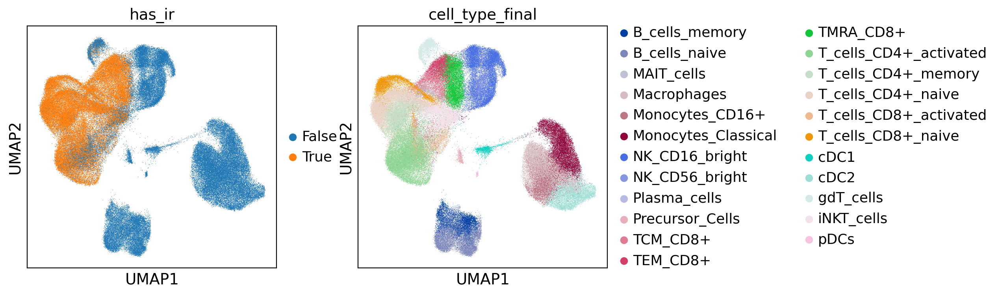

In [53]:
# any BCR data outside B cells (louvain cluster 1)?
sc.pl.umap(adata, color=['has_ir','cell_type_final'])


In [54]:
adata

AnnData object with n_obs × n_vars = 145823 × 2696
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type_final', 'S_score', 'G2M_score', 'phase', 'louvain', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', 

In [55]:
np.unique(adata.obs['donor'])

array(['CONTROL1', 'CONTROL2', 'CONTROL3', 'CONTROL4', 'CONTROL5',
       'CONTROL6', 'CONTROL7', 'CONTROL8', 'CONTROL9', 'CONTROL_twin',
       'CVID1', 'CVID18', 'CVID23', 'CVID25', 'CVID29', 'CVID3', 'CVID33',
       'CVID34', 'CVID36', 'CVID37', 'CVID_twin'], dtype=object)

In [61]:
np.unique(adata.obs['cell_type_final'])

array(['B_cells_memory', 'B_cells_naive', 'MAIT_cells', 'Macrophages',
       'Monocytes_CD16+', 'Monocytes_Classical', 'NK_CD16_bright',
       'NK_CD56_bright', 'Plasma_cells', 'Precursor_Cells', 'TCM_CD8+',
       'TEM_CD8+', 'TMRA_CD8+', 'T_cells_CD4+_activated',
       'T_cells_CD4+_memory', 'T_cells_CD4+_naive',
       'T_cells_CD8+_activated', 'T_cells_CD8+_naive', 'cDC1', 'cDC2',
       'gdT_cells', 'iNKT_cells', 'pDCs'], dtype=object)

In [62]:
# Subsetting to only T cell clusters (according to `cell_type_final`)
adata = adata[adata.obs['cell_type_final'].isin(['MAIT_cells','TCM_CD8+',
       'TEM_CD8+', 'TMRA_CD8+', 'T_cells_CD4+_activated',
       'T_cells_CD4+_memory', 'T_cells_CD4+_naive',
       'T_cells_CD8+_activated', 'T_cells_CD8+_naive',
       'gdT_cells', 'iNKT_cells'])].copy()

In [70]:
# ading a joint key of celltype + condition
adata.obs['celltype_condition'] = [i + '_' + j for i,j in zip(adata.obs['cell_type_final'], adata.obs['CVID_status'])]

In [71]:
# also making a copy of data only from twins

adata_twins = adata[adata.obs['donor'].isin(['CVID_twin','CONTROL_twin'])].copy()


<AxesSubplot:title={'center':'Number of cells in receptor_subtype by celltype_condition'}, xlabel='receptor_subtype', ylabel='Number of cells'>

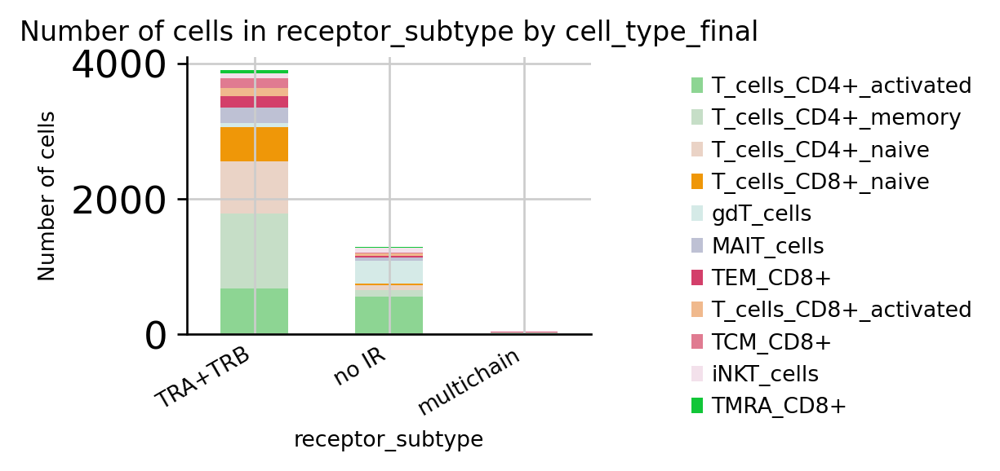

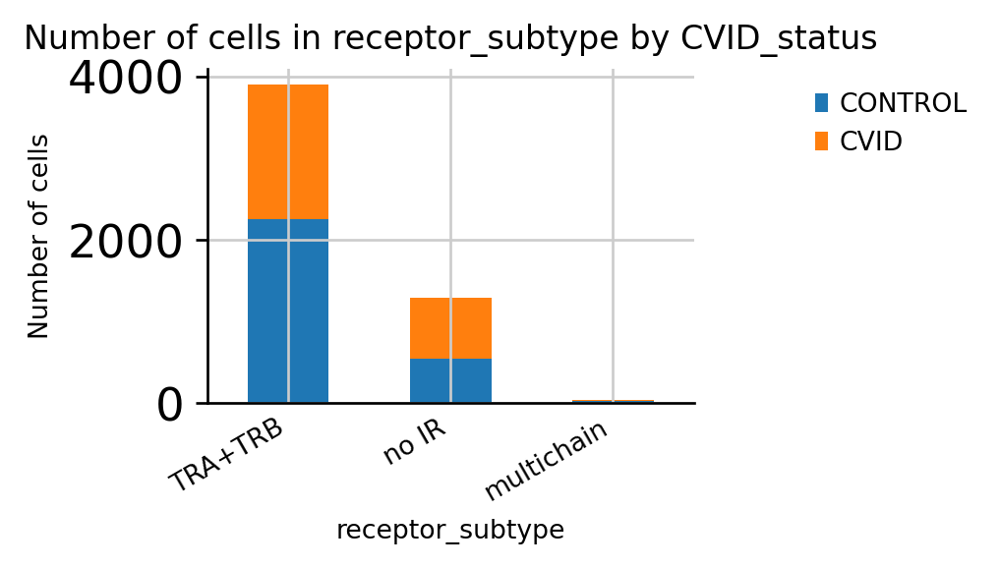

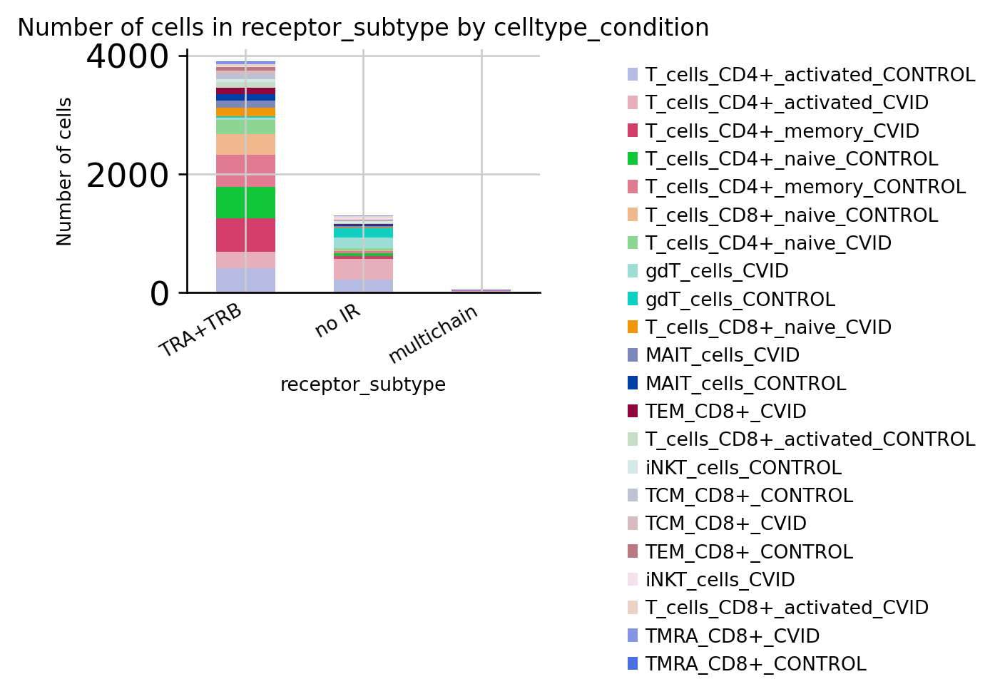

In [73]:
ir.pl.group_abundance(adata_twins, groupby="receptor_subtype", target_col="cell_type_final")
ir.pl.group_abundance(adata_twins, groupby="receptor_subtype", target_col="CVID_status")
ir.pl.group_abundance(adata_twins, groupby="receptor_subtype", target_col="celltype_condition")


<AxesSubplot:title={'center':'Number of cells in receptor_subtype by celltype_condition'}, xlabel='receptor_subtype', ylabel='Number of cells'>

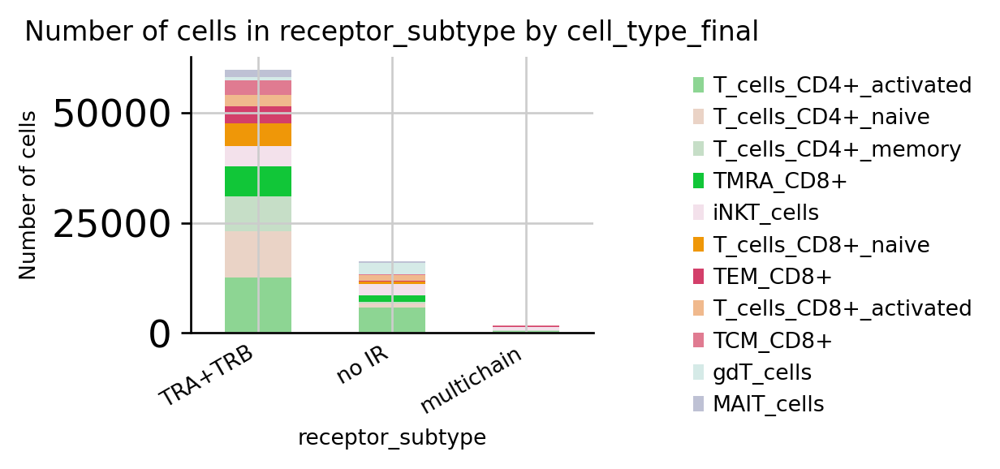

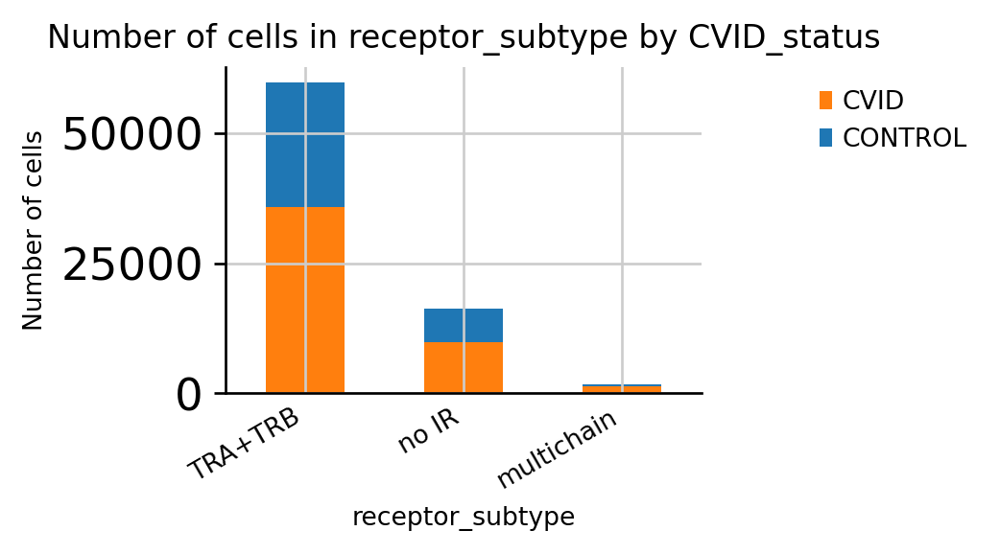

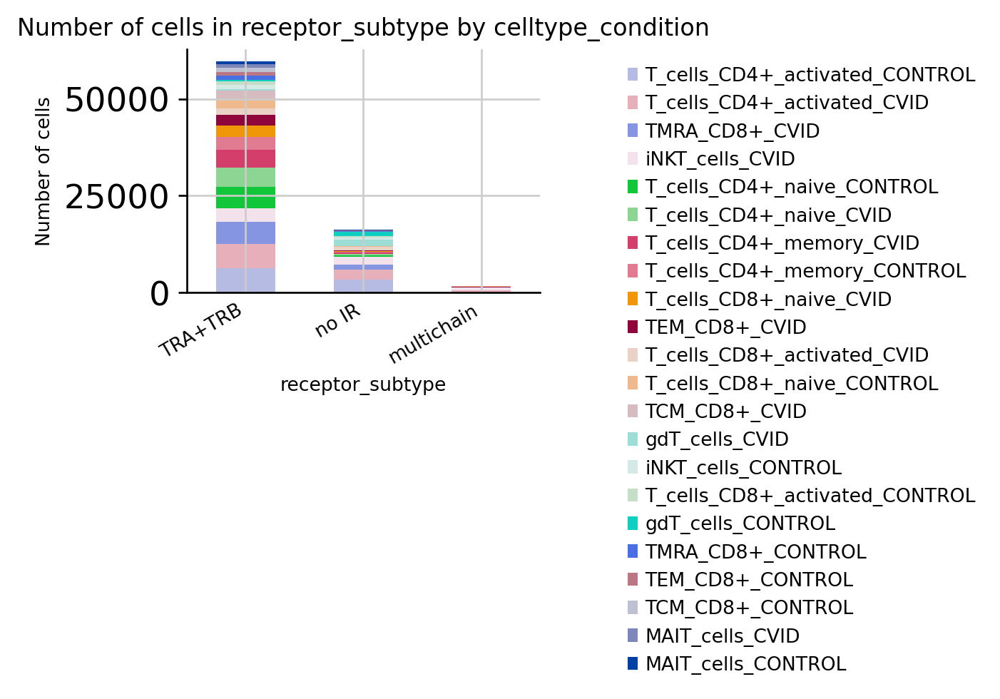

In [74]:
ir.pl.group_abundance(adata, groupby="receptor_subtype", target_col="cell_type_final")
ir.pl.group_abundance(adata, groupby="receptor_subtype", target_col="CVID_status")
ir.pl.group_abundance(adata, groupby="receptor_subtype", target_col="celltype_condition")


In [75]:
adata

AnnData object with n_obs × n_vars = 77696 × 2696
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type_final', 'S_score', 'G2M_score', 'phase', 'louvain', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', '

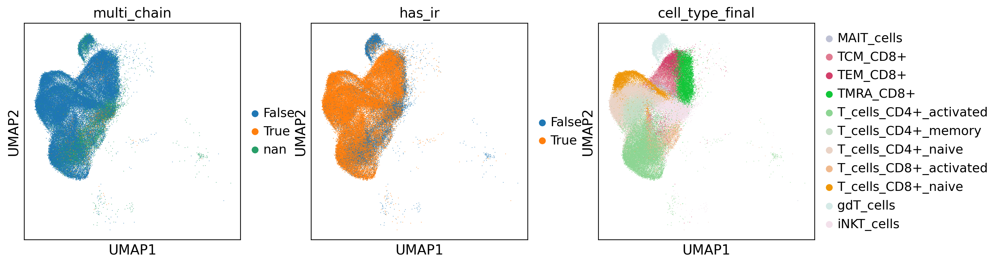

In [76]:
sc.pl.umap(adata, color=['multi_chain','has_ir','cell_type_final'])


# Define clonotypes and clonotype clusters


### Compute CDR3 neighborhood graph and define clonotypes


In [77]:
# using default parameters, `ir_neighbors` will compute nucleotide sequence identity
ir.pp.ir_neighbors(adata, receptor_arms="all", dual_ir="primary_only")
ir.tl.define_clonotypes(adata)

100%|██████████| 1446174/1446174 [00:12<00:00, 114733.46it/s]


... storing 'clonotype' as categorical


array([<AxesSubplot:title={'center':'clonotype'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

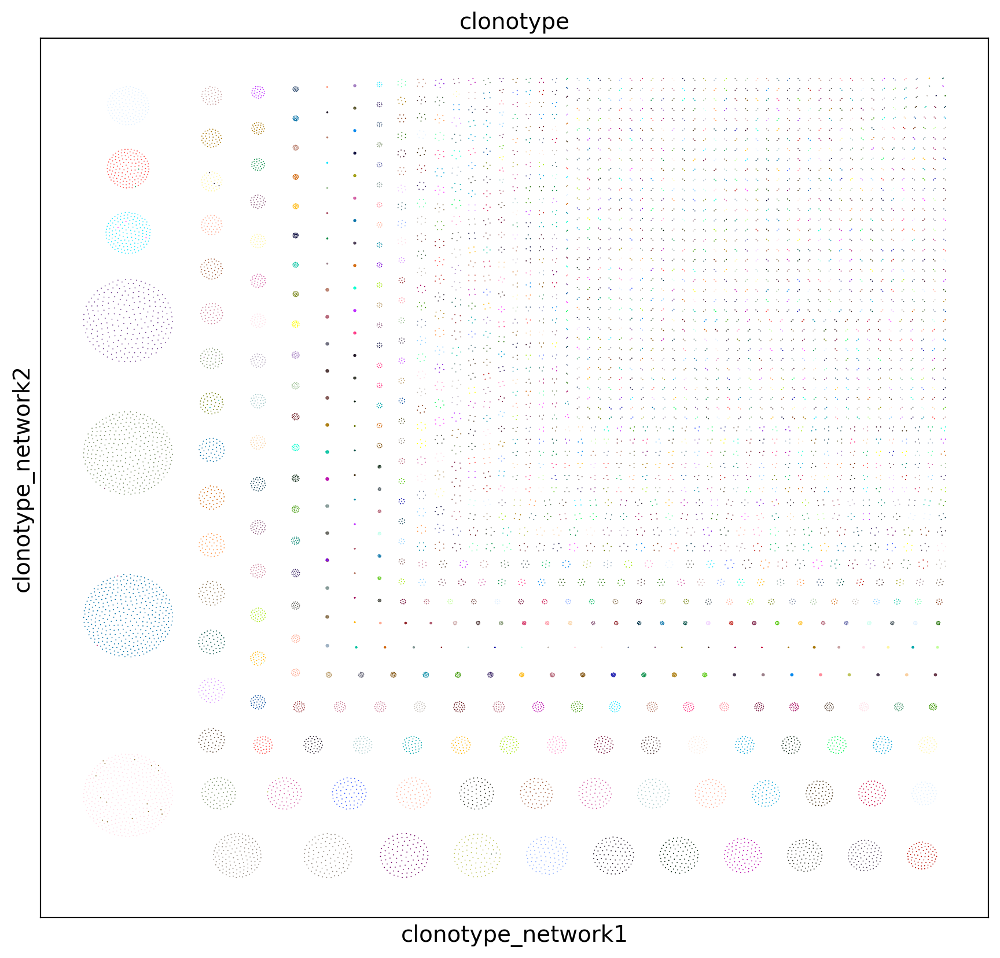

In [78]:
ir.tl.clonotype_network(adata, min_size=2)
ir.pl.clonotype_network(adata, color="clonotype", legend_loc="none")

In [79]:
# and for twins only
# using default parameters, `ir_neighbors` will compute nucleotide sequence identity
ir.pp.ir_neighbors(adata_twins, receptor_arms="all", dual_ir="primary_only")
ir.tl.define_clonotypes(adata_twins)

100%|██████████| 10056/10056 [00:00<00:00, 127528.23it/s]


... storing 'clonotype' as categorical


array([<AxesSubplot:title={'center':'clonotype'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

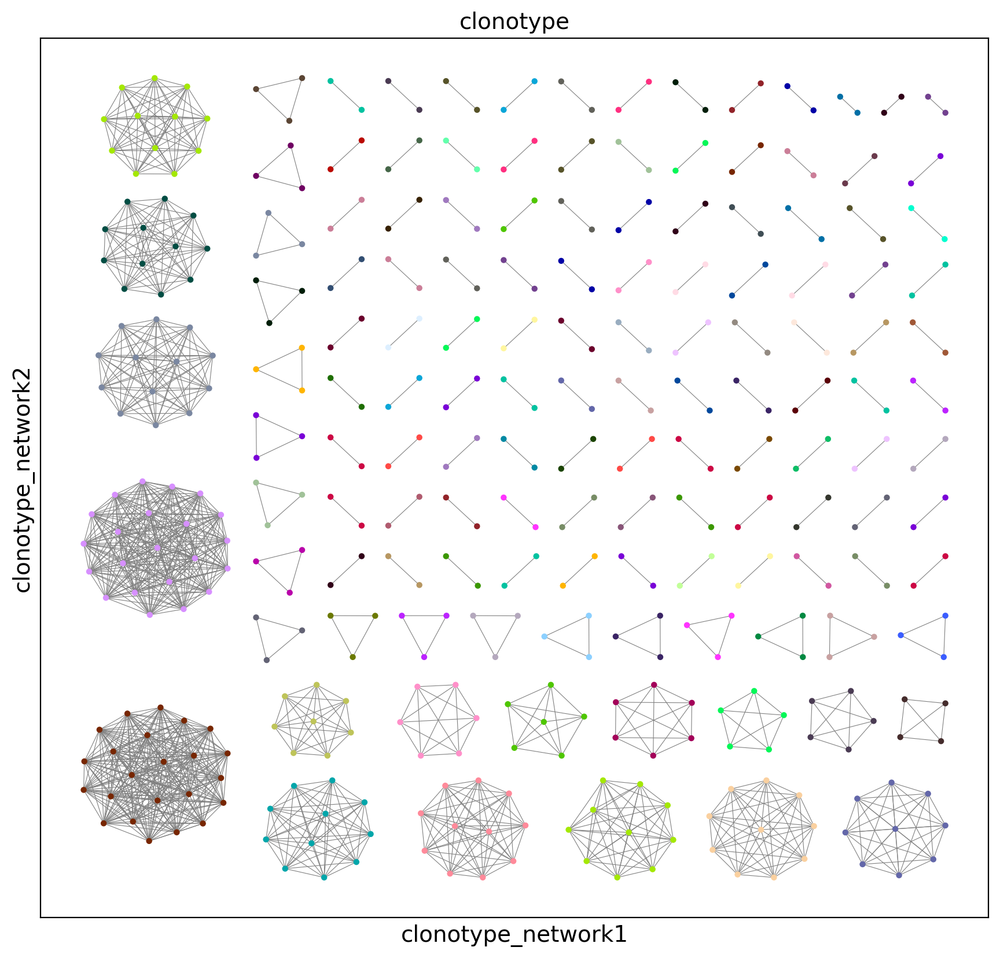

In [80]:
ir.tl.clonotype_network(adata_twins, min_size=2)
ir.pl.clonotype_network(adata_twins, color="clonotype", legend_loc="none")

## Re-compute CDR3 neighborhood graph and define clonotype clusters


In [81]:
ir.pp.ir_neighbors(
    adata,
    metric="alignment",
    sequence="aa",
    cutoff=15,
    receptor_arms="all",
    dual_ir="all",
)
ir.tl.define_clonotype_clusters(
    adata, partitions="connected", sequence="aa", metric="alignment", within_group=None
)

100%|██████████| 9135544/9135544 [00:46<00:00, 197720.44it/s]


In [82]:
ir.tl.clonotype_network(adata, min_size=4, sequence="aa", metric="alignment")


... storing 'ct_cluster_aa_alignment' as categorical


array([<AxesSubplot:title={'center':'ct_cluster_aa_alignment'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

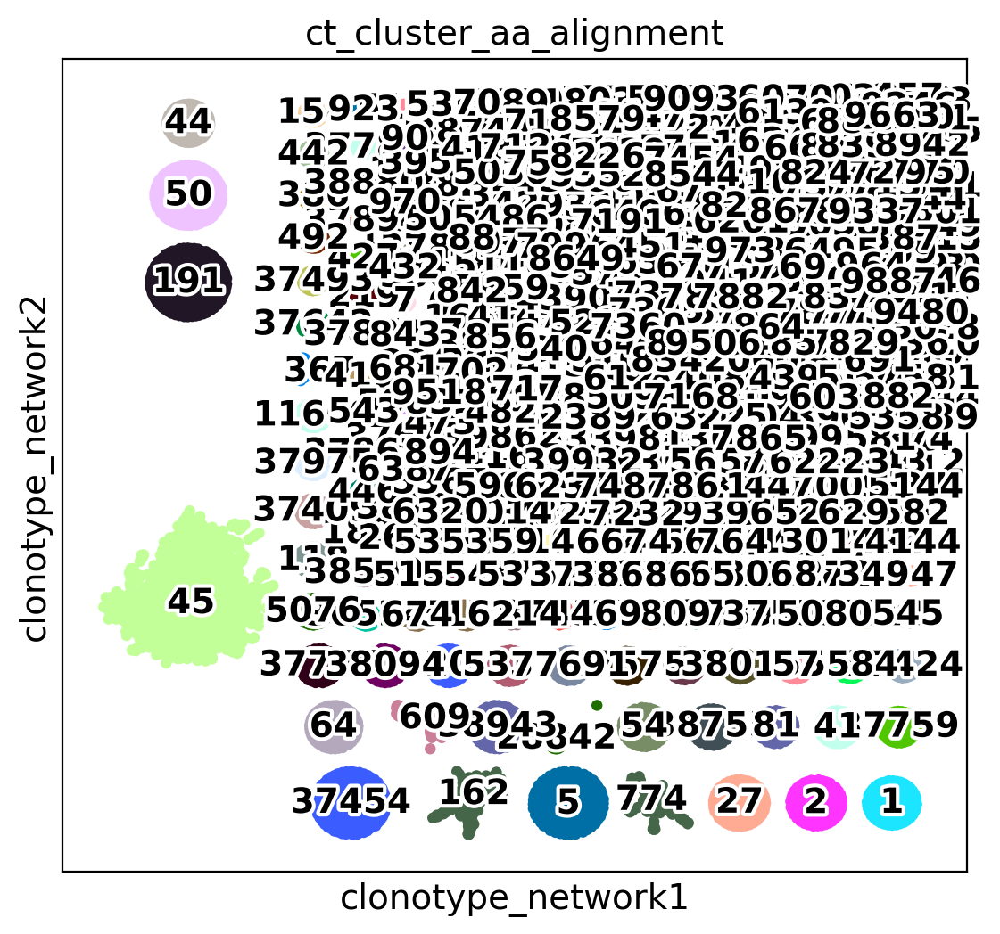

In [83]:
ir.pl.clonotype_network(
    adata,
    color="ct_cluster_aa_alignment",
    legend_fontoutline=3,
    size=80,
    panel_size=(6, 6),
    legend_loc="on data",
)

array([<AxesSubplot:title={'center':'donor'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

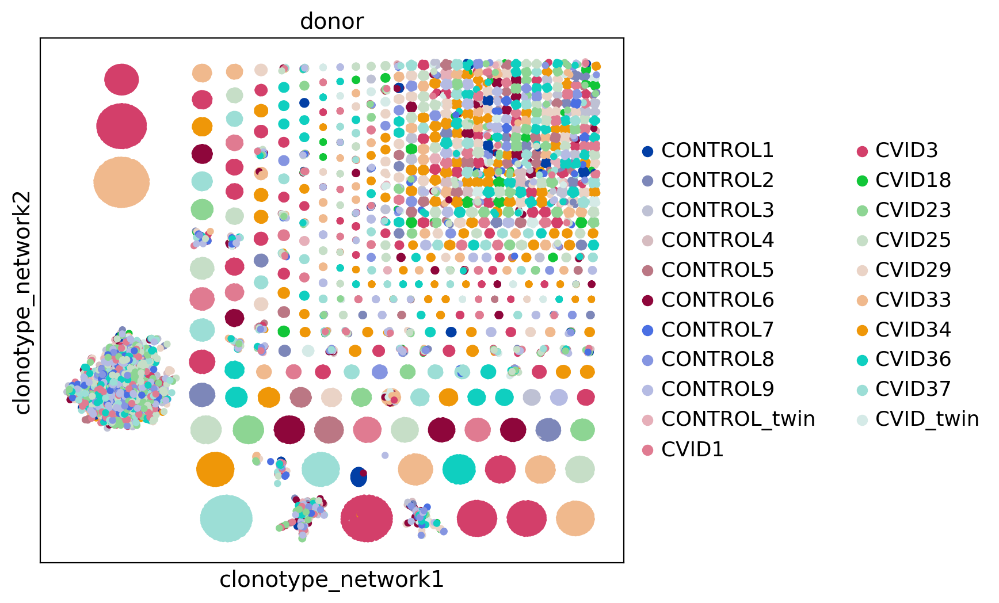

In [84]:
# to rerun
ir.pl.clonotype_network(adata, color="donor", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'CVID_status'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

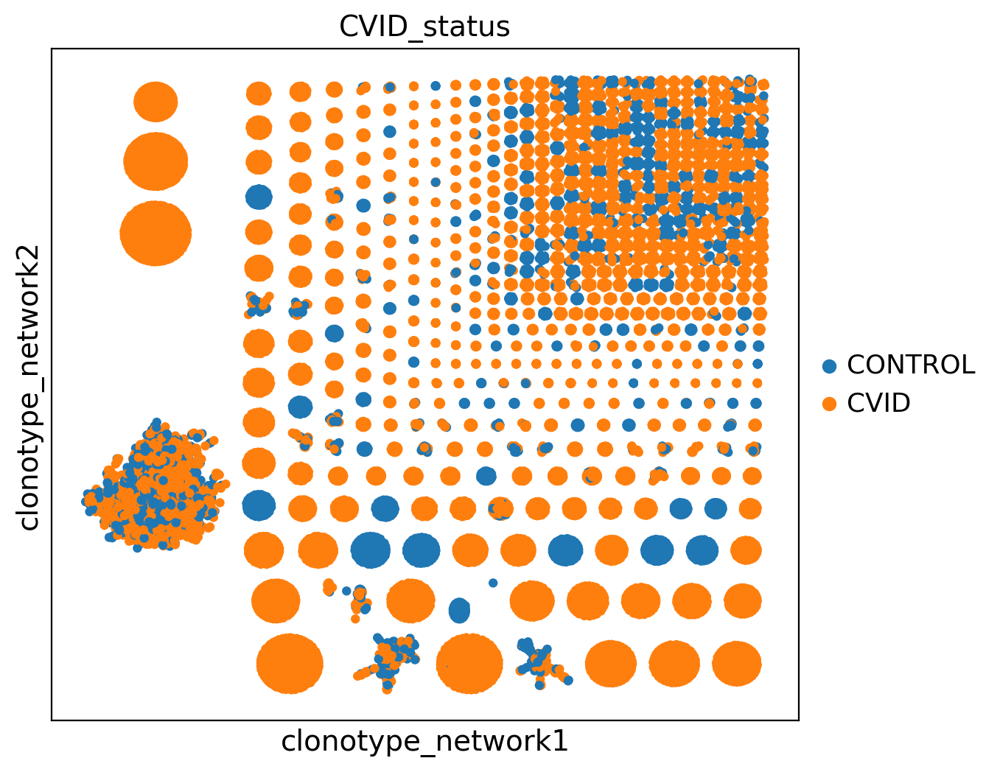

In [85]:
# to rerun
ir.pl.clonotype_network(adata, color="CVID_status", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'stimulation'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

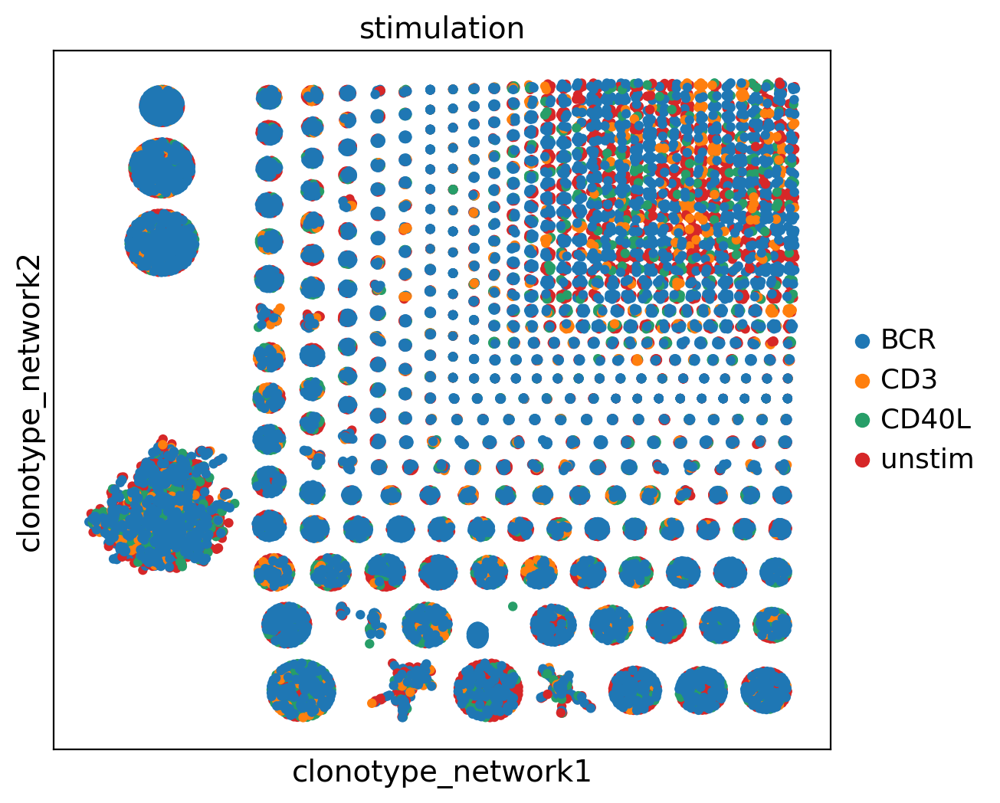

In [86]:
# to rerun
ir.pl.clonotype_network(adata, color="stimulation", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'cell_type_final'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

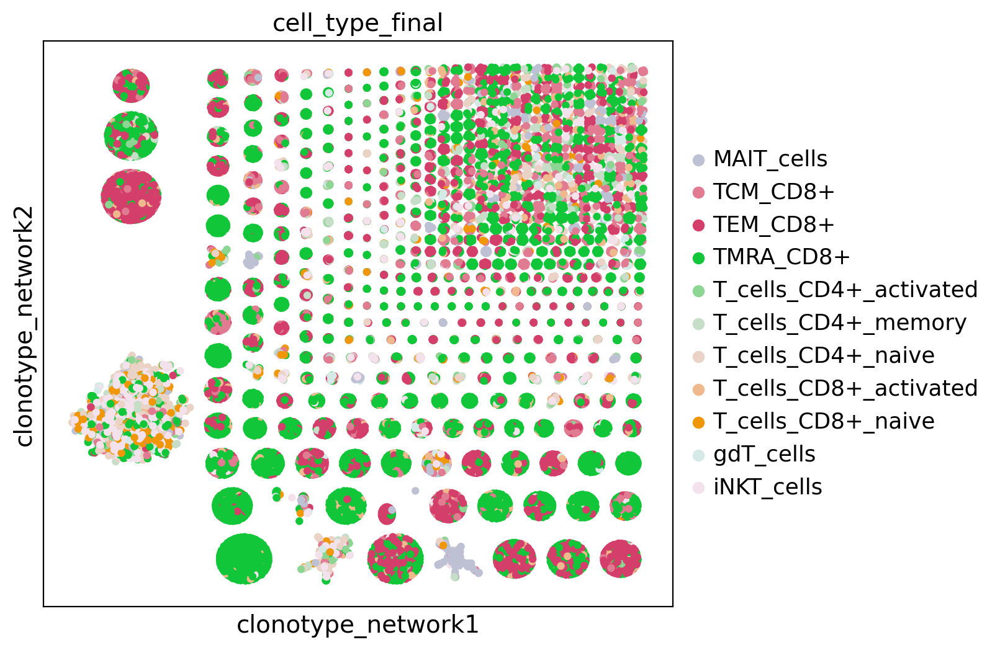

In [87]:
# to rerun
ir.pl.clonotype_network(adata, color="cell_type_final", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'celltype_condition'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

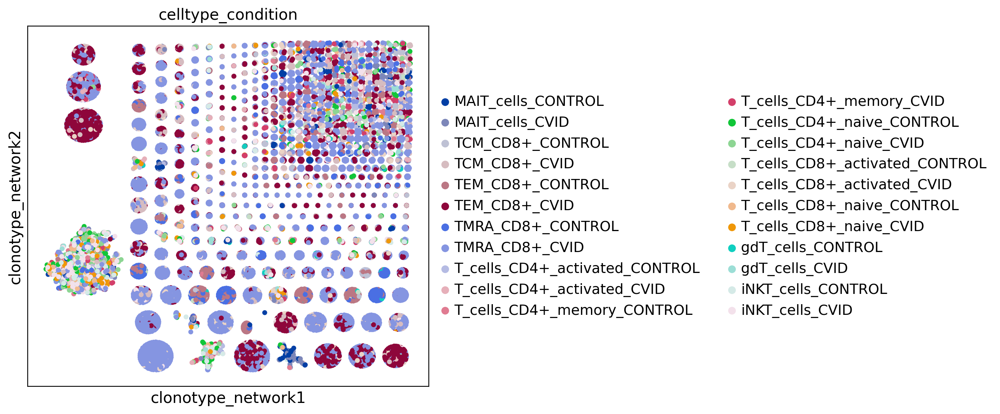

In [88]:
# to rerun
ir.pl.clonotype_network(adata, color="celltype_condition", size=80, panel_size=(6, 6))


In [89]:
adata.obs.loc[
    adata.obs["ct_cluster_aa_alignment"] == "117",
    [
        "IR_VJ_1_cdr3",
        "IR_VJ_2_cdr3",
        "IR_VDJ_1_cdr3",
        "IR_VDJ_2_cdr3",
        "receptor_subtype",
    ],
]

,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,receptor_subtype
AACCATGTCCGAACGC-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
TCGCGAGTCCGTCATC-1,CVVRKSGGSNYKLTF,None,None,None,TRA+TRB
ACTGATGGTAAATGTG-1,CALRNSGGSNYKLTF,None,None,None,TRA+TRB
GGACAAGTCAGTACGT-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
GGGATGAGTACCGGCT-1,CALSGGGSNYKLTF,None,None,None,TRA+TRB
AAGGAGCCAATGAATG-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
ACCGTAAAGCAACGGT-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
CATTCGCTCTTAGAGC-1-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
CCGTTCAAGGGAACGG-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB
CCTACCACAGCATACT-1,CAVQAGGSNYKLTF,None,None,None,TRA+TRB


In [90]:
ir.pp.ir_neighbors(
    adata_twins,
    metric="alignment",
    sequence="aa",
    cutoff=15,
    receptor_arms="all",
    dual_ir="all",
)
ir.tl.define_clonotype_clusters(
    adata_twins, partitions="connected", sequence="aa", metric="alignment", within_group=None
)

100%|██████████| 60486/60486 [00:00<00:00, 195935.48it/s]


In [91]:
ir.tl.clonotype_network(adata_twins, min_size=4, sequence="aa", metric="alignment")


... storing 'ct_cluster_aa_alignment' as categorical


array([<AxesSubplot:title={'center':'ct_cluster_aa_alignment'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

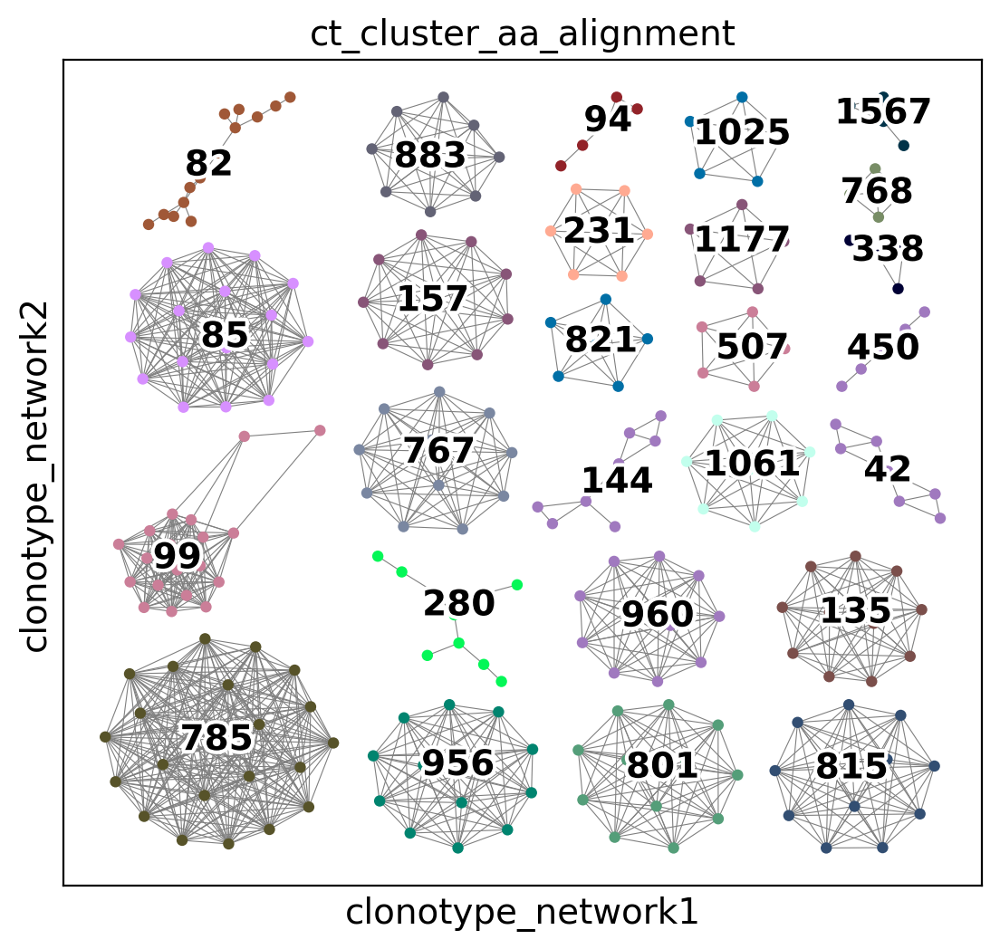

In [92]:
ir.pl.clonotype_network(
    adata_twins,
    color="ct_cluster_aa_alignment",
    legend_fontoutline=3,
    size=80,
    panel_size=(6, 6),
    legend_loc="on data",
)

array([<AxesSubplot:title={'center':'donor'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

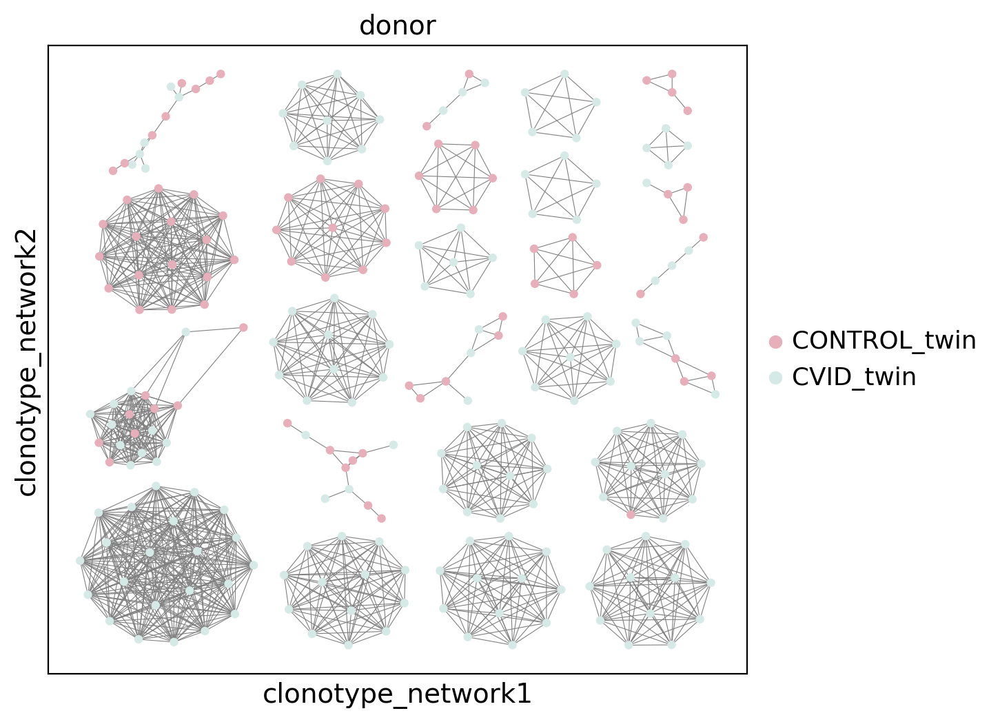

In [93]:
# to rerun
ir.pl.clonotype_network(adata_twins, color="donor", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'CVID_status'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

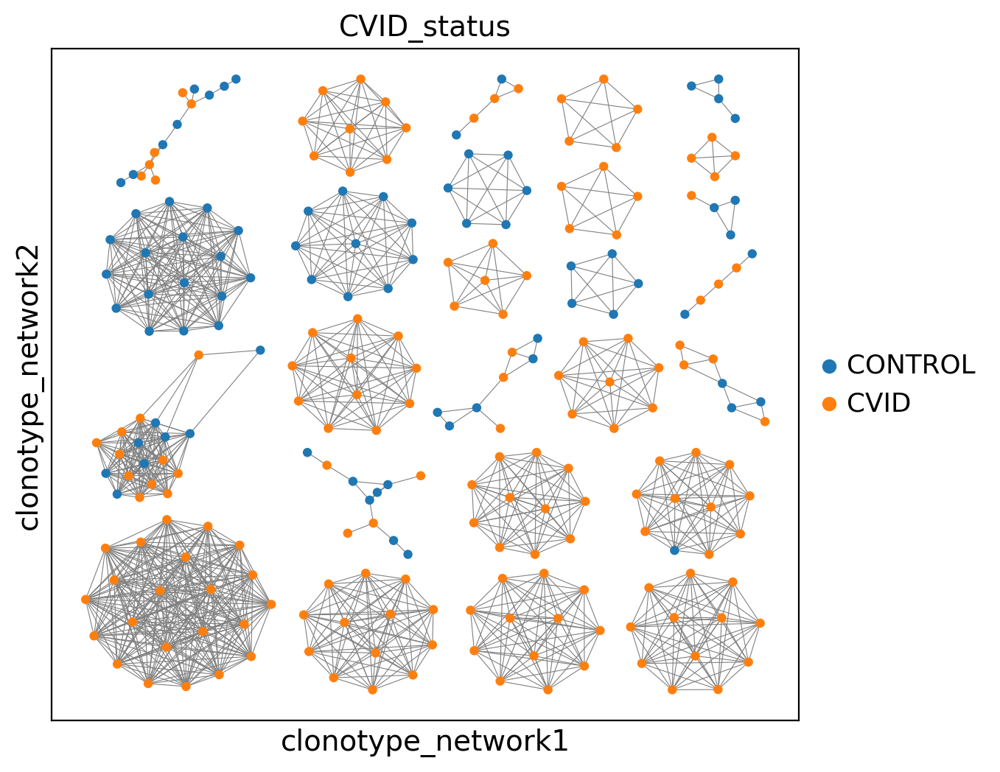

In [94]:
# to rerun
ir.pl.clonotype_network(adata_twins, color="CVID_status", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'stimulation'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

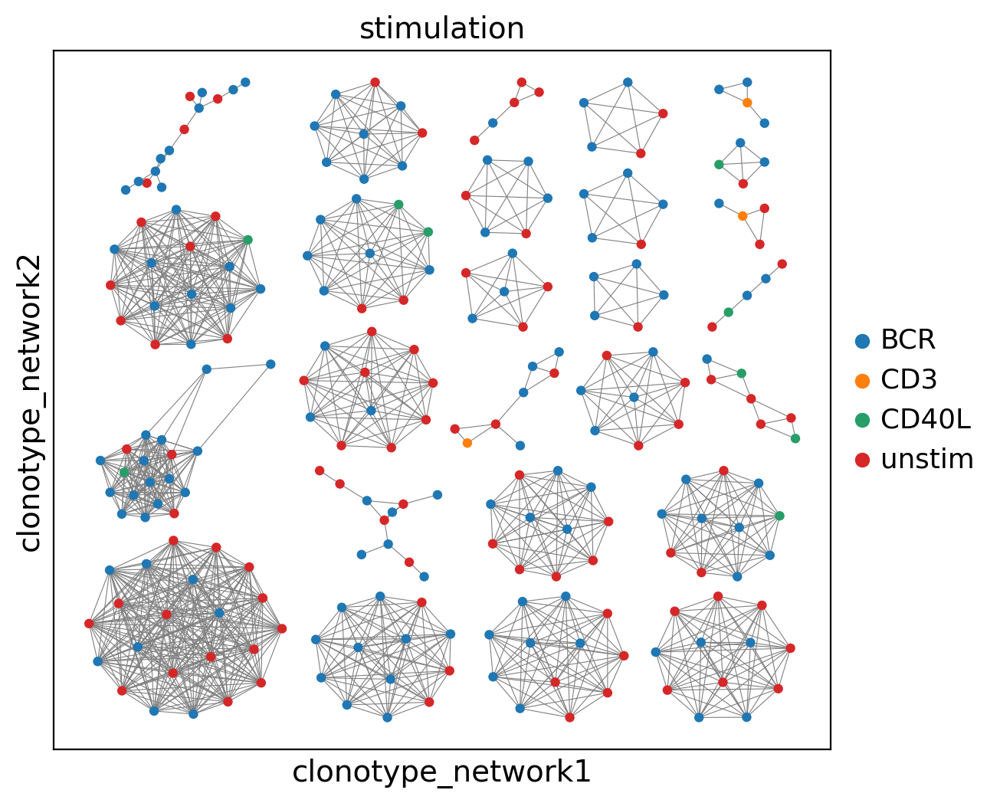

In [95]:
# to rerun
ir.pl.clonotype_network(adata_twins, color="stimulation", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'cell_type_final'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

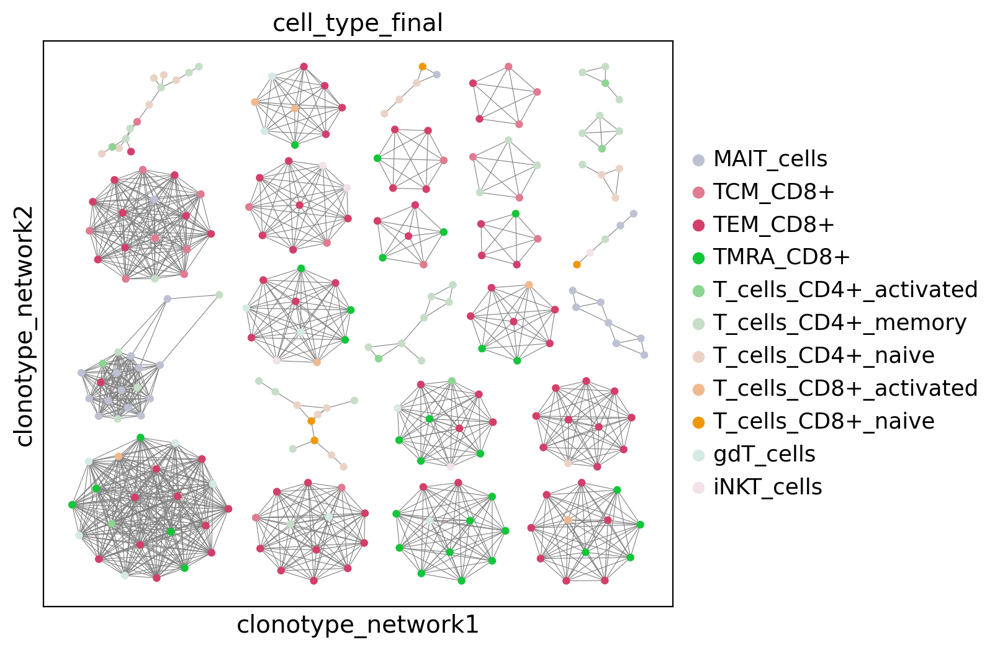

In [96]:
# to rerun
ir.pl.clonotype_network(adata_twins, color="cell_type_final", size=80, panel_size=(6, 6))


array([<AxesSubplot:title={'center':'celltype_condition'}, xlabel='clonotype_network1', ylabel='clonotype_network2'>],
      dtype=object)

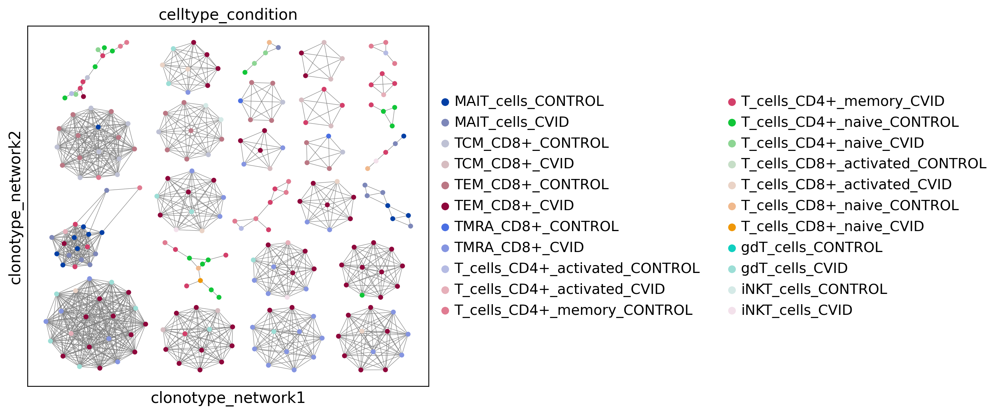

In [97]:
# to rerun
ir.pl.clonotype_network(adata_twins, color="celltype_condition", size=80, panel_size=(6, 6))


In [98]:
adata_twins.obs.loc[
    adata_twins.obs["ct_cluster_aa_alignment"] == "117",
    [
        "IR_VJ_1_cdr3",
        "IR_VJ_2_cdr3",
        "IR_VDJ_1_cdr3",
        "IR_VDJ_2_cdr3",
        "receptor_subtype",
    ],
]

,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,receptor_subtype
AGGTCCGTCATTGCGA-1,CAVNGNNAGNMLTF,None,CASSRLVTDTQYF,None,TRA+TRB


## Including the V-gene in clonotype definition


In [99]:
ir.tl.define_clonotype_clusters(
    adata,
    sequence="aa",
    metric="alignment",
    same_v_gene="primary_only",
    key_added="ct_cluster_aa_alignment_same_v",
)

In [100]:
# find clonotypes with more than one `clonotype_same_v`
ct_different_v = adata.obs.groupby("ct_cluster_aa_alignment").apply(
    lambda x: x["ct_cluster_aa_alignment_same_v"].unique().size > 1
)
ct_different_v = ct_different_v[ct_different_v].index.values
ct_different_v

['17', '18', '44', '45', '59', ..., '58218', '59199', '60500', '60579', '61835']
Length: 724
Categories (63590, object): ['0', '1', '2', '3', ..., '63586', '63587', '63588', '63589']

In [101]:
# Display the first 2 clonotypes with different v genes
adata.obs.loc[
    adata.obs["ct_cluster_aa_alignment"].isin(ct_different_v[:2]),
    [
        "ct_cluster_aa_alignment",
        "ct_cluster_aa_alignment_same_v",
        "IR_VJ_1_v_gene",
        "IR_VDJ_1_v_gene",
    ],
].sort_values("ct_cluster_aa_alignment").drop_duplicates().reset_index(drop=True)

,ct_cluster_aa_alignment,ct_cluster_aa_alignment_same_v,IR_VJ_1_v_gene,IR_VDJ_1_v_gene
0,17,17_TRAV14DV4_TRBV10-2_TCR,TRAV14DV4,TRBV10-2
1,17,17_TRAV8-4_TRBV10-2_TCR,TRAV8-4,TRBV10-2
2,18,18_TRAV8-3_TRBV19_TCR,TRAV8-3,TRBV19
3,18,18_TRAV27_TRBV12-3_TCR,TRAV27,TRBV12-3


In [102]:
ir.tl.define_clonotype_clusters(
    adata_twins,
    sequence="aa",
    metric="alignment",
    same_v_gene="primary_only",
    key_added="ct_cluster_aa_alignment_same_v",
)

In [103]:
# find clonotypes with more than one `clonotype_same_v`
ct_different_v = adata_twins.obs.groupby("ct_cluster_aa_alignment").apply(
    lambda x: x["ct_cluster_aa_alignment_same_v"].unique().size > 1
)
ct_different_v = ct_different_v[ct_different_v].index.values
ct_different_v

['42', '73', '82', '94', '99', ..., '2363', '2967', '2993', '3996', '4432']
Length: 33
Categories (4874, object): ['0', '1', '2', '3', ..., '4870', '4871', '4872', '4873']

In [104]:
# Display the first 2 clonotypes with different v genes
adata_twins.obs.loc[
    adata_twins.obs["ct_cluster_aa_alignment"].isin(ct_different_v[:2]),
    [
        "ct_cluster_aa_alignment",
        "ct_cluster_aa_alignment_same_v",
        "IR_VJ_1_v_gene",
        "IR_VDJ_1_v_gene",
    ],
].sort_values("ct_cluster_aa_alignment").drop_duplicates().reset_index(drop=True)

,ct_cluster_aa_alignment,ct_cluster_aa_alignment_same_v,IR_VJ_1_v_gene,IR_VDJ_1_v_gene
0,42,42_TRAV1-2_TRBV6-4_TCR,TRAV1-2,TRBV6-4
1,42,42_TRAV1-2_TRBV6-1_TCR,TRAV1-2,TRBV6-1
2,42,42_TRAV1-2_TRBV6-3_TCR,TRAV1-2,TRBV6-3
3,73,73_TRAV20_TRBV19_TCR,TRAV20,TRBV19
4,73,73_TRAV29DV5_TRBV7-2_TCR,TRAV29DV5,TRBV7-2


# Clonotype analysis


### Clonal expansion


In [105]:
ir.tl.clonal_expansion(adata)
ir.tl.clonal_expansion(adata_twins)


... storing 'ct_cluster_aa_alignment_same_v' as categorical
... storing 'clonal_expansion' as categorical


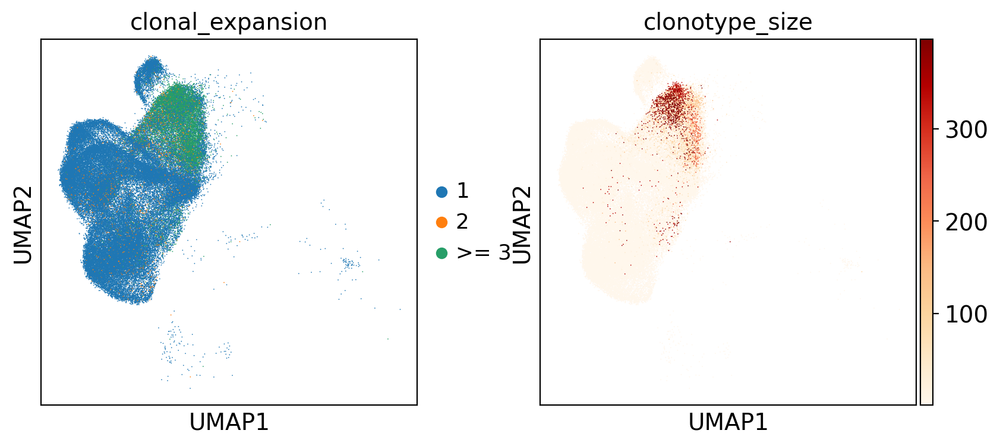

In [106]:
sc.pl.umap(adata, color=["clonal_expansion", "clonotype_size"], cmap='OrRd')


/opt/conda/lib/python3.8/site-packages/anndata/compat/__init__.py:210: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_nt_identity']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  warn(
/opt/conda/lib/python3.8/site-packages/anndata/compat/__init__.py:210: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_nt_identity']['distances'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  warn(
/opt/conda/lib/python3.8/site-packages/anndata/compat/__init__.py:210: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the 

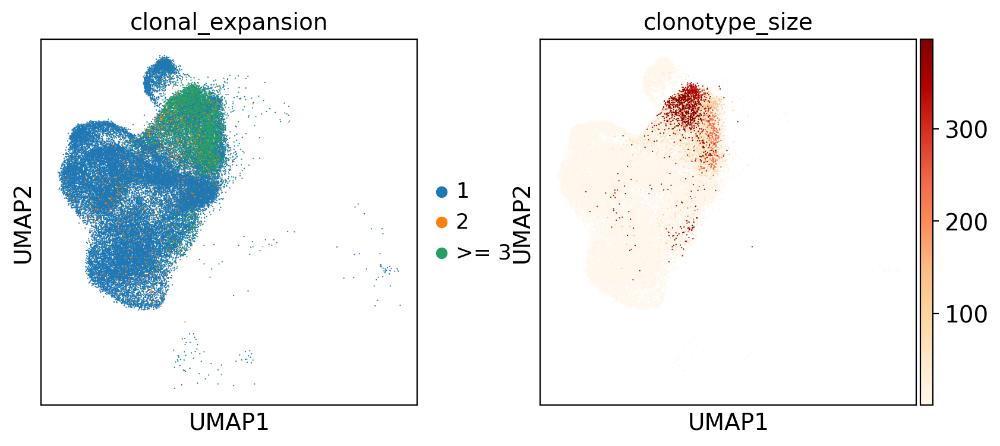

In [117]:
sc.pl.umap(adata[adata.obs['CVID_status'] == 'CVID'], color=["clonal_expansion", "clonotype_size"], cmap='OrRd')


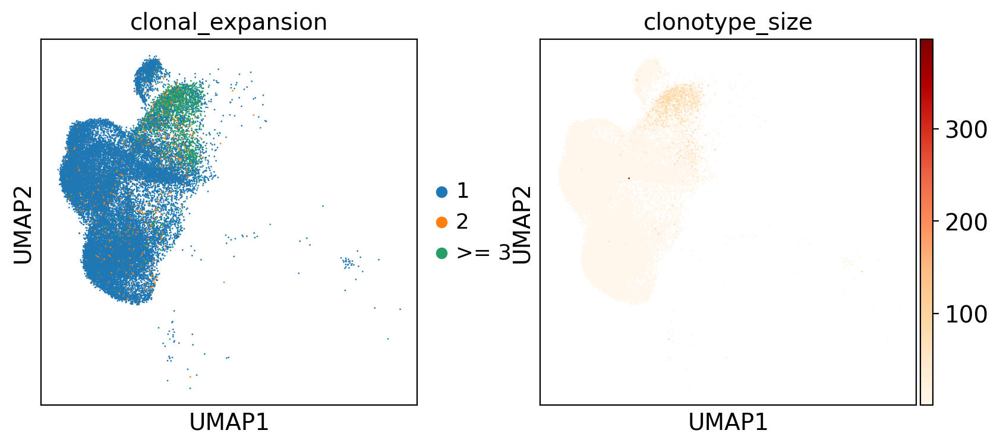

In [118]:
sc.pl.umap(adata[adata.obs['CVID_status'] == 'CONTROL'], color=["clonal_expansion", "clonotype_size"], cmap='OrRd')


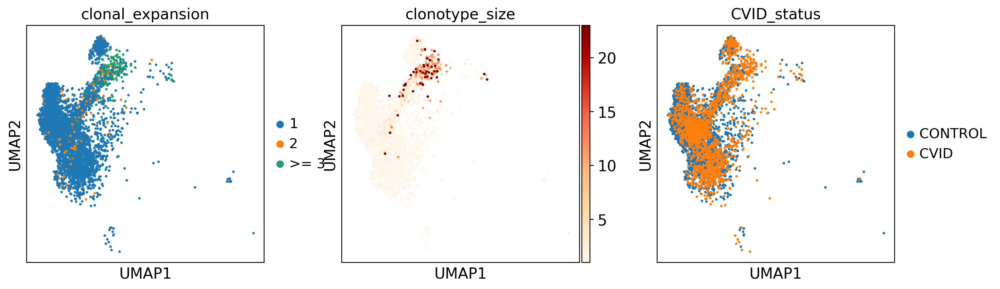

In [9]:
sc.pl.umap(adata_twins, color=["clonal_expansion", "clonotype_size", 'CVID_status'], cmap='OrRd')


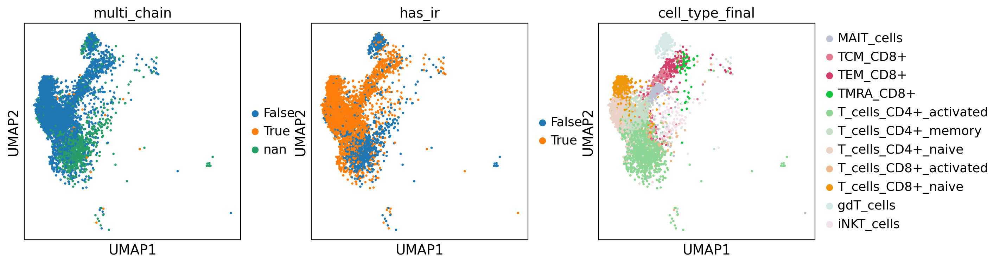

In [10]:
sc.pl.umap(adata_twins, color=["multi_chain", "has_ir",'cell_type_final'], cmap='OrRd')


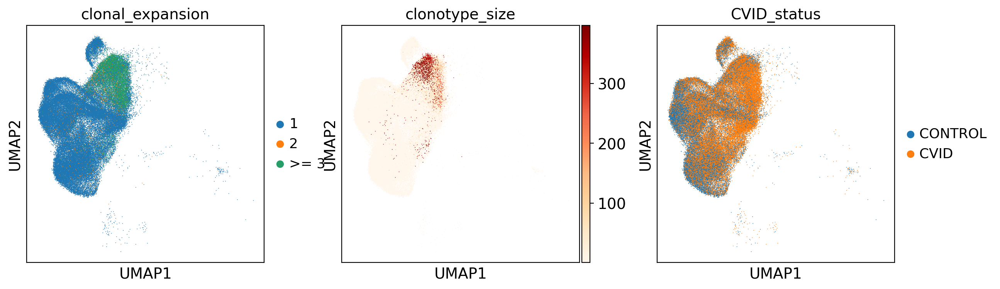

In [11]:
sc.pl.umap(adata, color=["clonal_expansion", "clonotype_size", 'CVID_status'], cmap='OrRd')


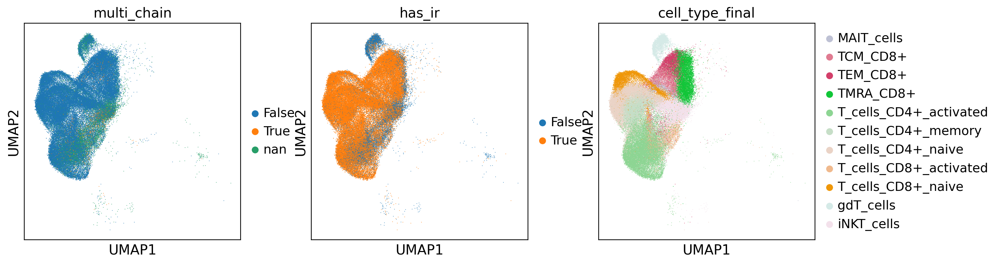

In [12]:
sc.pl.umap(adata, color=["multi_chain", "has_ir",'cell_type_final'], cmap='OrRd')


<AxesSubplot:>

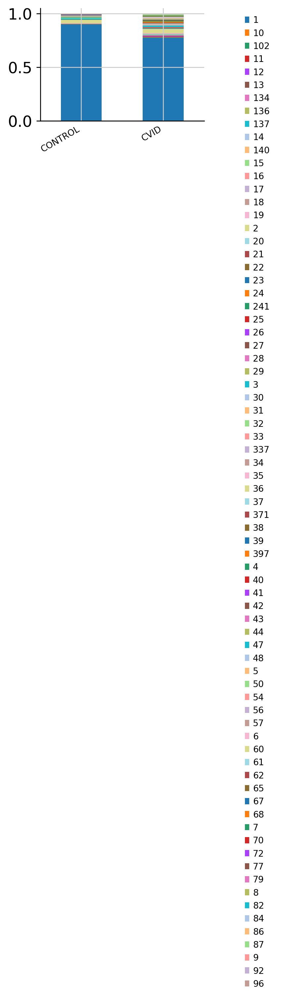

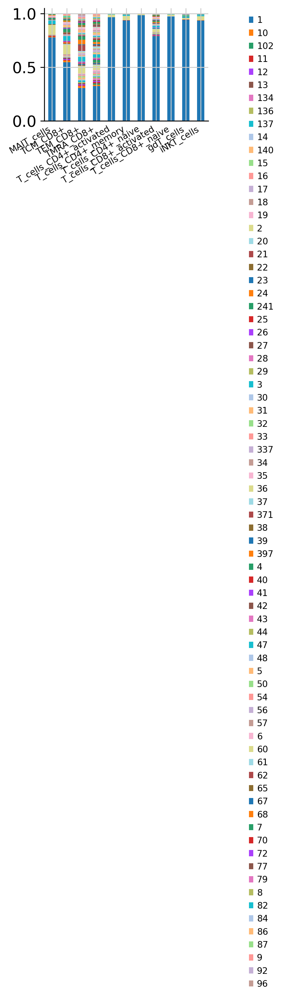

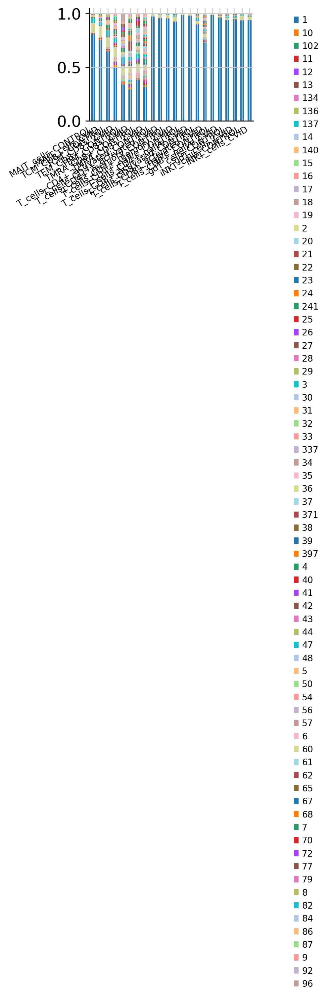

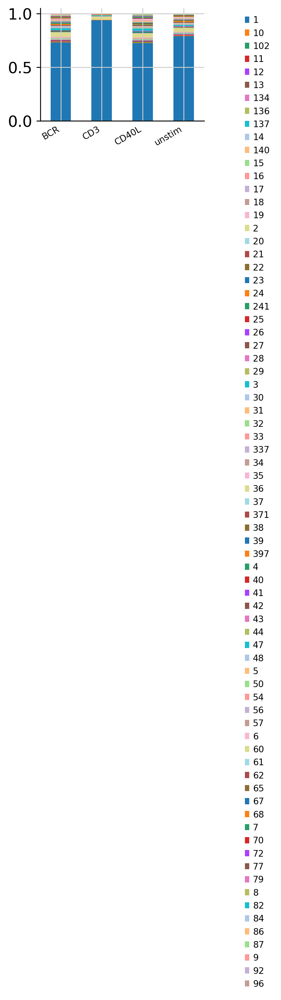

In [13]:
normalize_boolean = True

ir.pl.clonal_expansion(adata, groupby="CVID_status", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata, groupby="cell_type_final", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata, groupby="celltype_condition", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata, groupby="stimulation", clip_at=1000, normalize=normalize_boolean)


<AxesSubplot:>

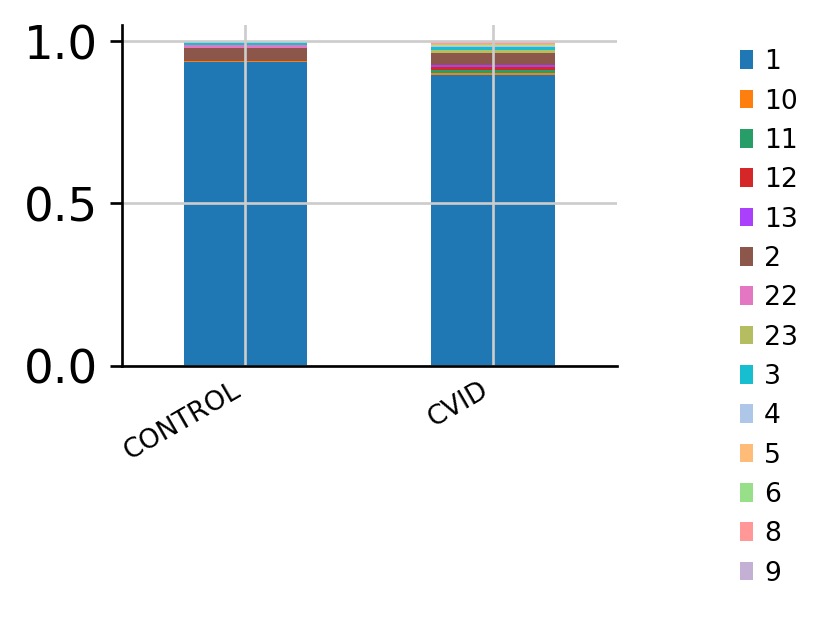

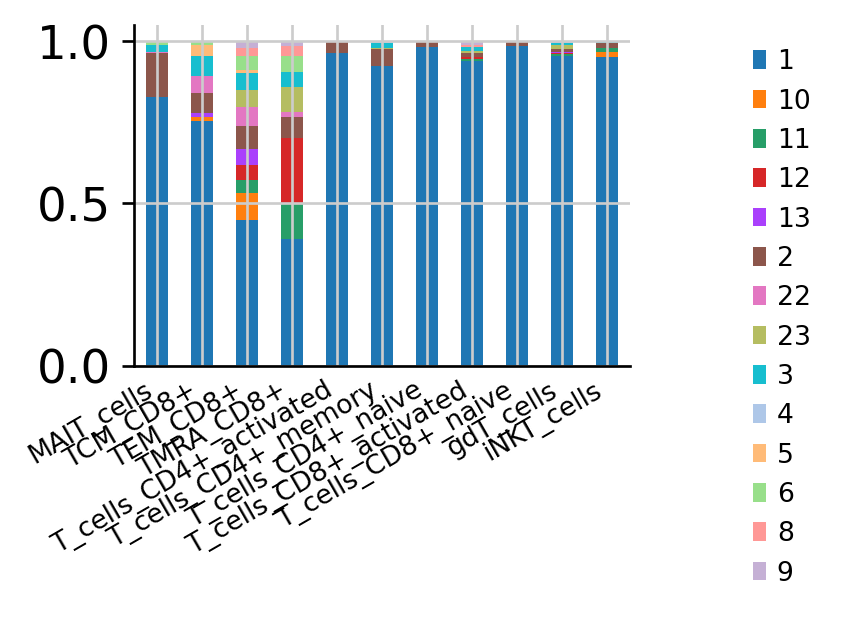

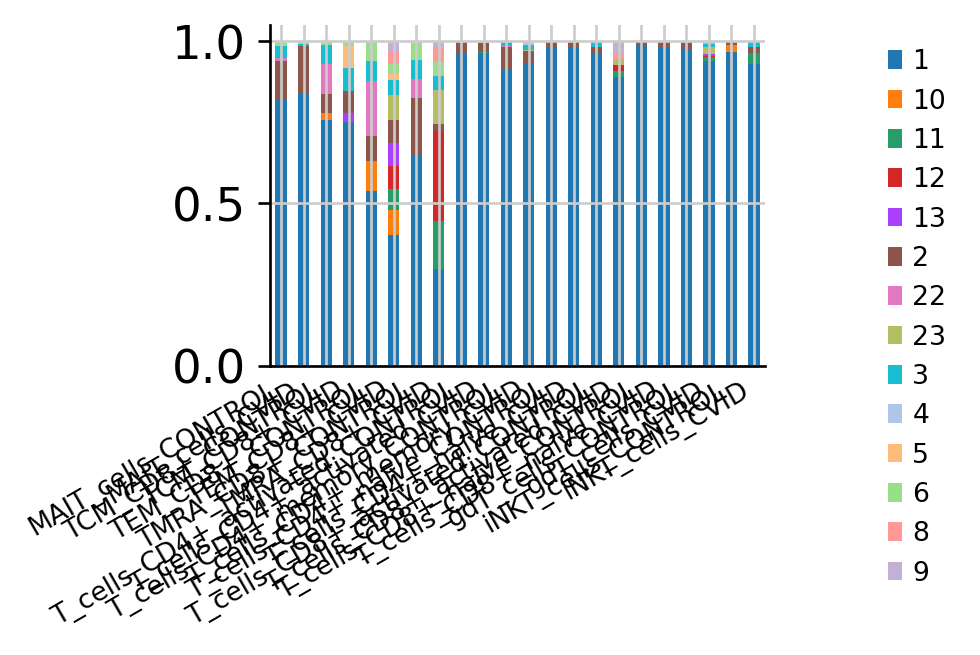

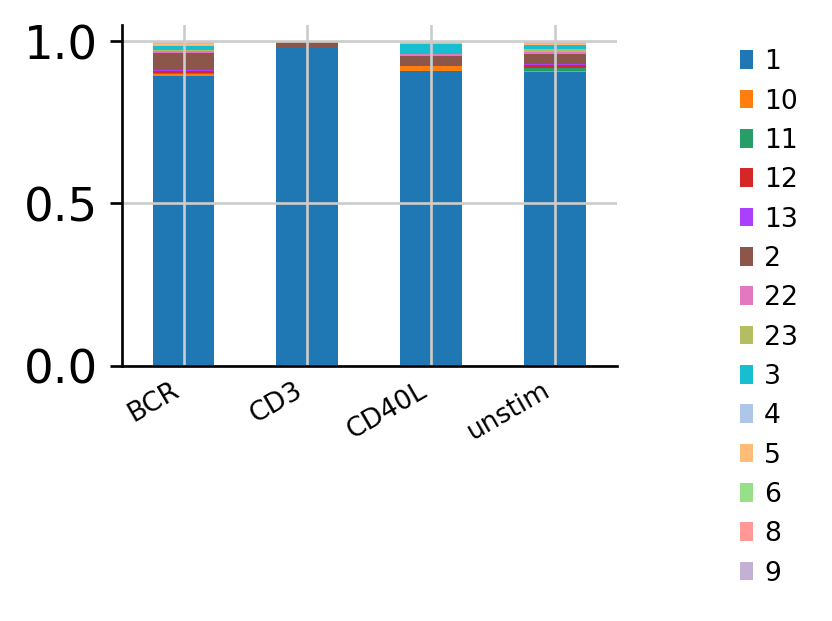

In [14]:
normalize_boolean = True

ir.pl.clonal_expansion(adata_twins, groupby="CVID_status", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata_twins, groupby="cell_type_final", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata_twins, groupby="celltype_condition", clip_at=1000, normalize=normalize_boolean)
ir.pl.clonal_expansion(adata_twins, groupby="stimulation", clip_at=1000, normalize=normalize_boolean)


<AxesSubplot:>

<Figure size 2000x1000 with 0 Axes>

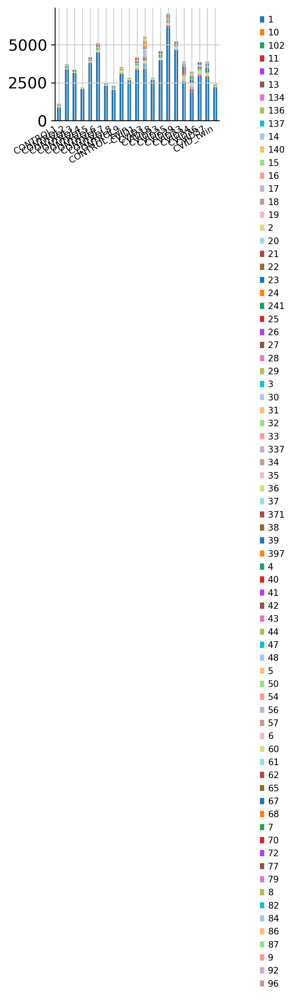

In [119]:
plt.figure(figsize=(20,10))
ir.pl.clonal_expansion(adata, groupby="donor", clip_at=1000,
                       normalize=False)


<AxesSubplot:>

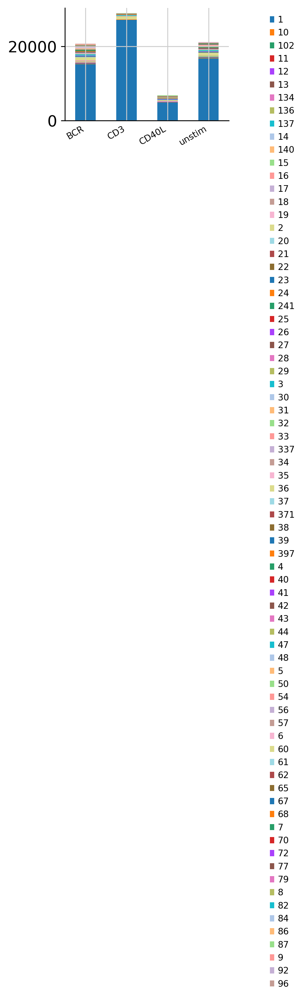

In [120]:
ir.pl.clonal_expansion(adata, groupby="stimulation", clip_at=1000,
                       normalize=False)


<AxesSubplot:>

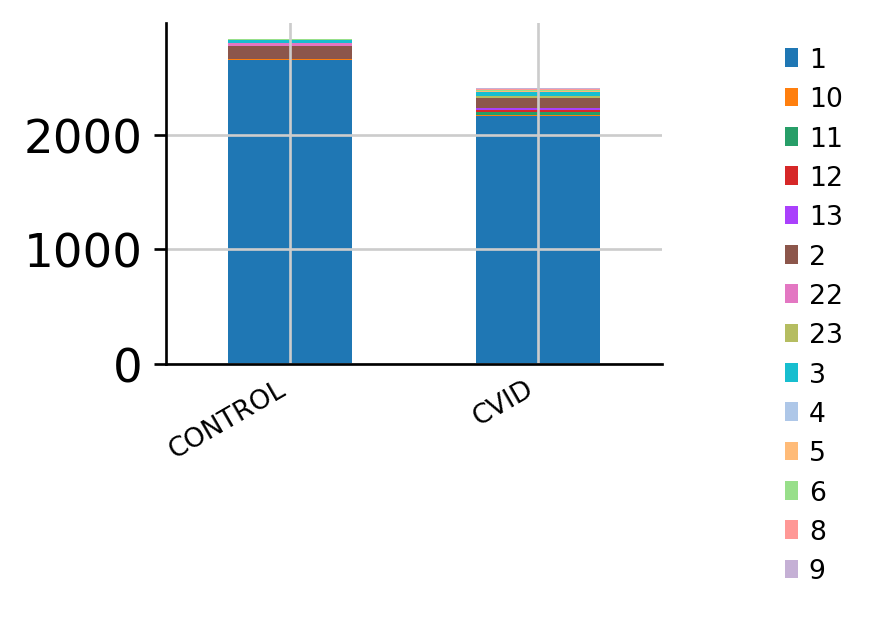

In [121]:
ir.pl.clonal_expansion(adata_twins, groupby="CVID_status", clip_at=1000, normalize=False)


<AxesSubplot:>

<Figure size 2000x1000 with 0 Axes>

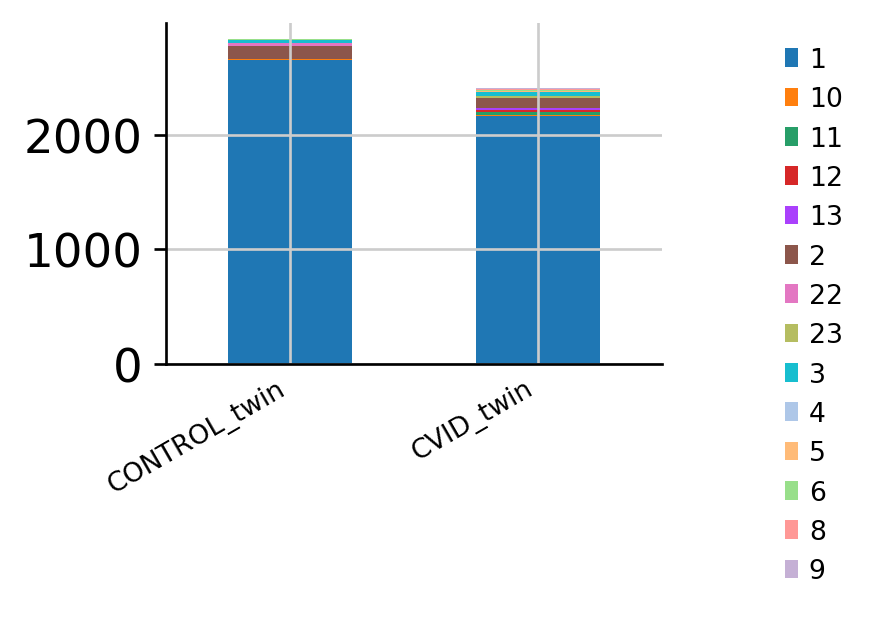

In [122]:
plt.figure(figsize=(20,10))
ir.pl.clonal_expansion(adata_twins, groupby="donor", clip_at=1000,
                       normalize=False)


<AxesSubplot:>

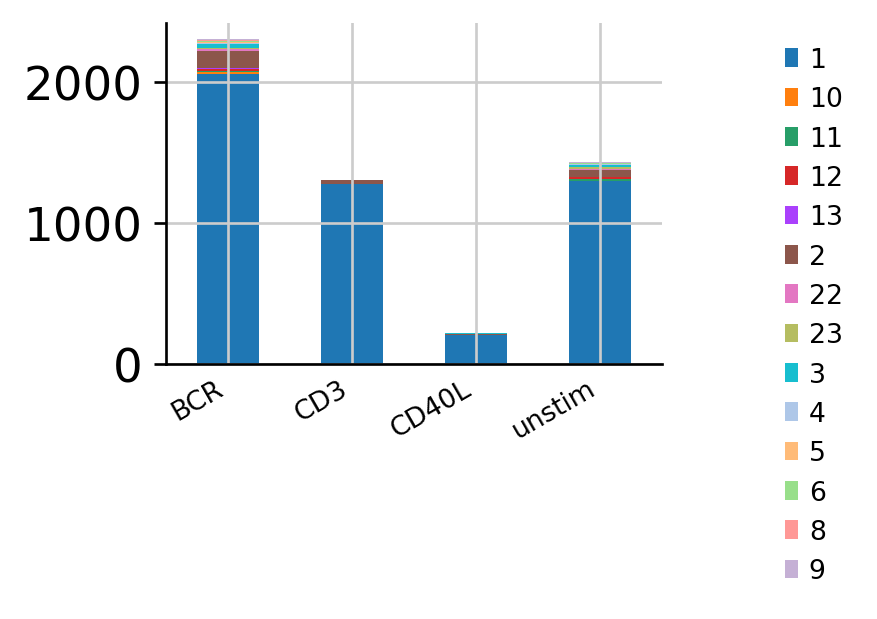

In [123]:
ir.pl.clonal_expansion(adata_twins, groupby="stimulation", clip_at=1000,
                       normalize=False)


In [126]:
adata

AnnData object with n_obs × n_vars = 77696 × 2696
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type_final', 'S_score', 'G2M_score', 'phase', 'louvain', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', '

In [127]:
adata.write(save_path + '20210113_adata_final_all_donors_with_TCR_information.h5ad')

In [128]:
adata_twins.write(save_path + '20210113_adata_final_twins_only_with_TCR_information.h5ad')

# Reading previously saved adatas with calculated TCR results

In [6]:
adata = sc.read(save_path + '20210113_adata_final_all_donors_with_TCR_information.h5ad')

In [7]:
adata_twins = sc.read(save_path + '20210113_adata_final_twins_only_with_TCR_information.h5ad')

In [8]:
# which cells are in the expanded clonotypes (size >= 2)?
adata.obs['expanded_or_not_2_or_more'] = ['True' if value != '1' else 'False' for value in adata.obs['clonal_expansion']]
# which cells are in the expanded clonotypes (size >= 3)?
adata.obs['expanded_or_not_3_or_more'] = ['True' if value not in ['1','2'] else 'False' for value in adata.obs['clonal_expansion']]

... storing 'expanded_or_not_2_or_more' as categorical
... storing 'expanded_or_not_3_or_more' as categorical


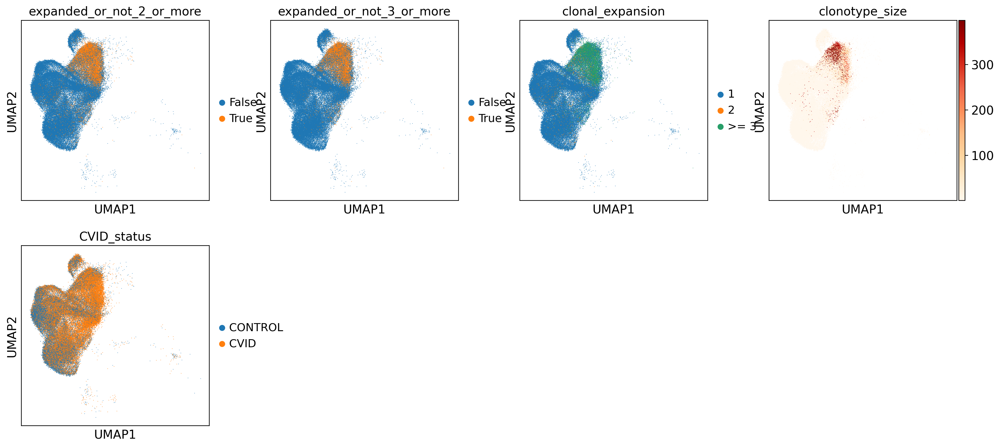

In [51]:
sc.pl.umap(adata, color=["expanded_or_not_2_or_more",
                         'expanded_or_not_3_or_more',
                         "clonal_expansion", "clonotype_size", 'CVID_status'], cmap='OrRd')


In [9]:
# which cells are in the expanded clonotypes (size >= 2)?
adata_twins.obs['expanded_or_not_2_or_more'] = ['True' if value != '1' else 'False' for value in adata_twins.obs['clonal_expansion']]
# which cells are in the expanded clonotypes (size >= 3)?
adata_twins.obs['expanded_or_not_3_or_more'] = ['True' if value not in ['1','2'] else 'False' for value in adata_twins.obs['clonal_expansion']]

... storing 'expanded_or_not_2_or_more' as categorical
... storing 'expanded_or_not_3_or_more' as categorical


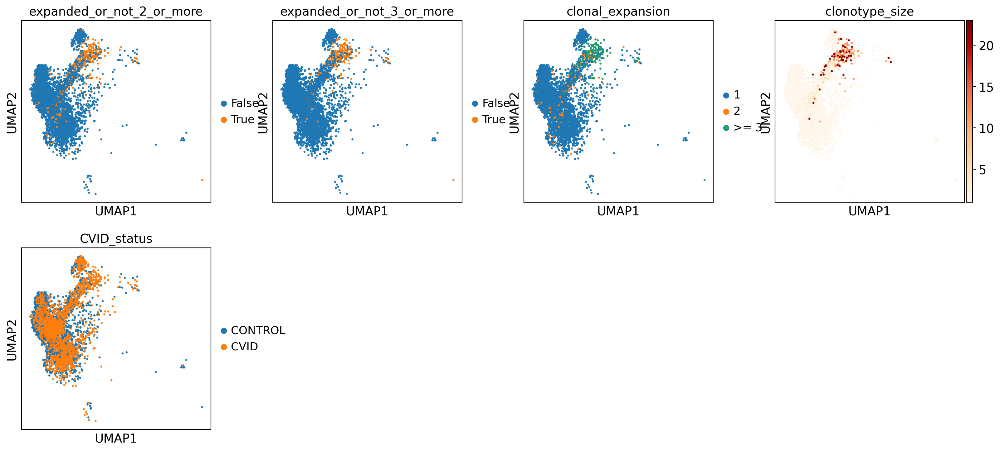

In [53]:
sc.pl.umap(adata_twins, color=["expanded_or_not_2_or_more",
                         'expanded_or_not_3_or_more',
                         "clonal_expansion", "clonotype_size", 'CVID_status'], cmap='OrRd')


In [54]:
adata[adata.obs['CVID_status'] == 'CONTROL'].obs['expanded_or_not_2_or_more'].value_counts()

False    27797
True      3025
Name: expanded_or_not_2_or_more, dtype: int64

In [57]:
3025 / (3025 + 27797)

0.09814418272662384

In [55]:
adata[adata.obs['CVID_status'] == 'CVID'].obs['expanded_or_not_2_or_more'].value_counts()

False    36282
True     10592
Name: expanded_or_not_2_or_more, dtype: int64

In [58]:
10592 / (10592 + 36282)

0.22596748730639588

In [59]:
adata_twins[adata_twins.obs['CVID_status'] == 'CONTROL'].obs['expanded_or_not_2_or_more'].value_counts()

False    2656
True      179
Name: expanded_or_not_2_or_more, dtype: int64

In [60]:
179 / (179 + 2656)

0.06313932980599647

In [61]:
adata_twins[adata_twins.obs['CVID_status'] == 'CVID'].obs['expanded_or_not_2_or_more'].value_counts()

False    2163
True      248
Name: expanded_or_not_2_or_more, dtype: int64

In [62]:
248 / (248 + 2163)

0.10286188303608461

In [63]:
adata[adata.obs['CVID_status'] == 'CONTROL'].obs['expanded_or_not_3_or_more'].value_counts()

False    28722
True      2100
Name: expanded_or_not_3_or_more, dtype: int64

In [67]:
2100 / (2100 + 28722)

0.06813315164492895

In [64]:
adata[adata.obs['CVID_status'] == 'CVID'].obs['expanded_or_not_3_or_more'].value_counts()

False    37947
True      8927
Name: expanded_or_not_3_or_more, dtype: int64

In [68]:
8927 / (8927 + 37947)

0.19044672953022998

In [65]:
adata_twins[adata_twins.obs['CVID_status'] == 'CONTROL'].obs['expanded_or_not_3_or_more'].value_counts()

False    2768
True       67
Name: expanded_or_not_3_or_more, dtype: int64

In [69]:
67 / (67 + 2768)

0.0236331569664903

In [66]:
adata_twins[adata_twins.obs['CVID_status'] == 'CVID'].obs['expanded_or_not_3_or_more'].value_counts()

False    2251
True      160
Name: expanded_or_not_3_or_more, dtype: int64

In [70]:
160 / (160 + 2251)

0.06636250518457072

In [71]:
adata.obs['stimulation_condition'] = [i + '_' + j for i,j in zip(adata.obs['stimulation'], adata.obs['CVID_status'])]

<AxesSubplot:>

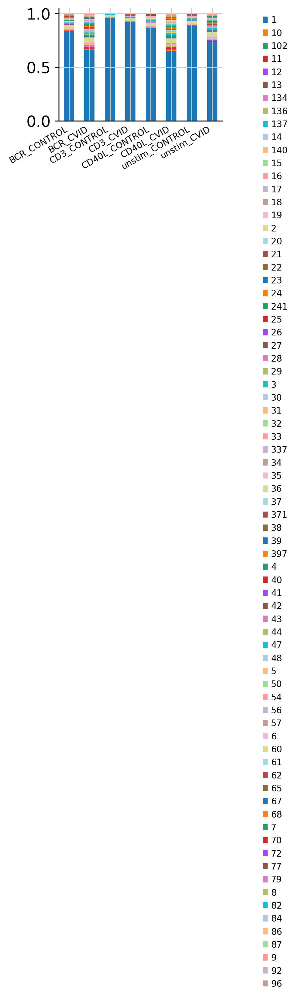

In [72]:
ir.pl.clonal_expansion(adata, groupby="stimulation_condition", clip_at=1000, normalize=True)


In [73]:
adata_twins.obs['stimulation_condition'] = [i + '_' + j for i,j in zip(adata_twins.obs['stimulation'], adata_twins.obs['CVID_status'])]

<AxesSubplot:>

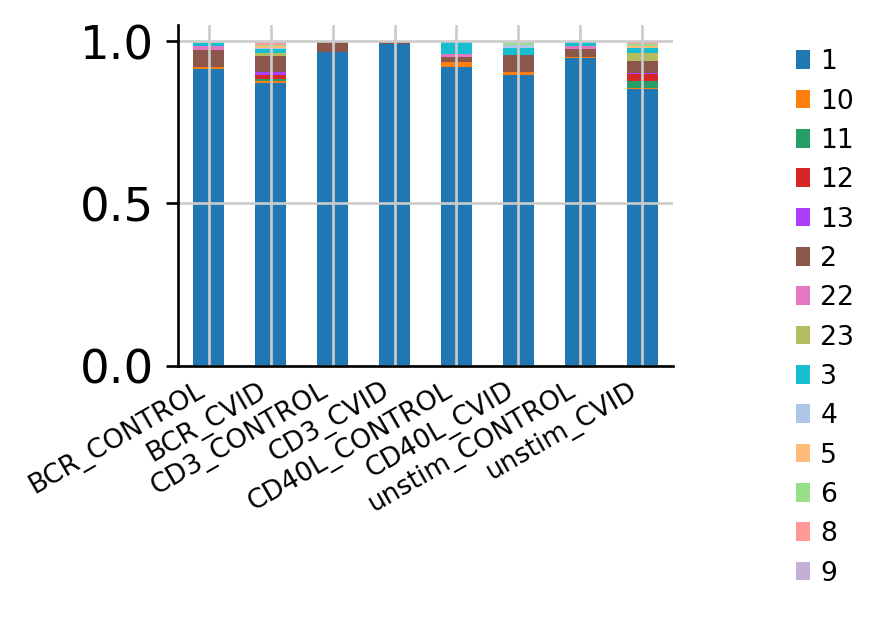

In [74]:
ir.pl.clonal_expansion(adata_twins, groupby="stimulation_condition", clip_at=1000, normalize=True)


In [77]:
adata

AnnData object with n_obs × n_vars = 77696 × 2696
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type_final', 'S_score', 'G2M_score', 'phase', 'louvain', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', '

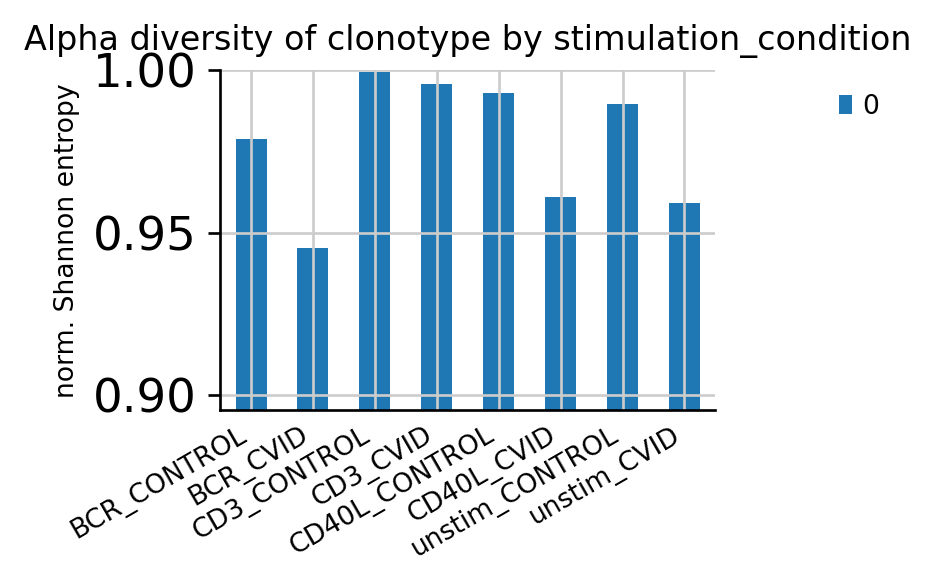

In [75]:
ax = ir.pl.alpha_diversity(adata, groupby="stimulation_condition")


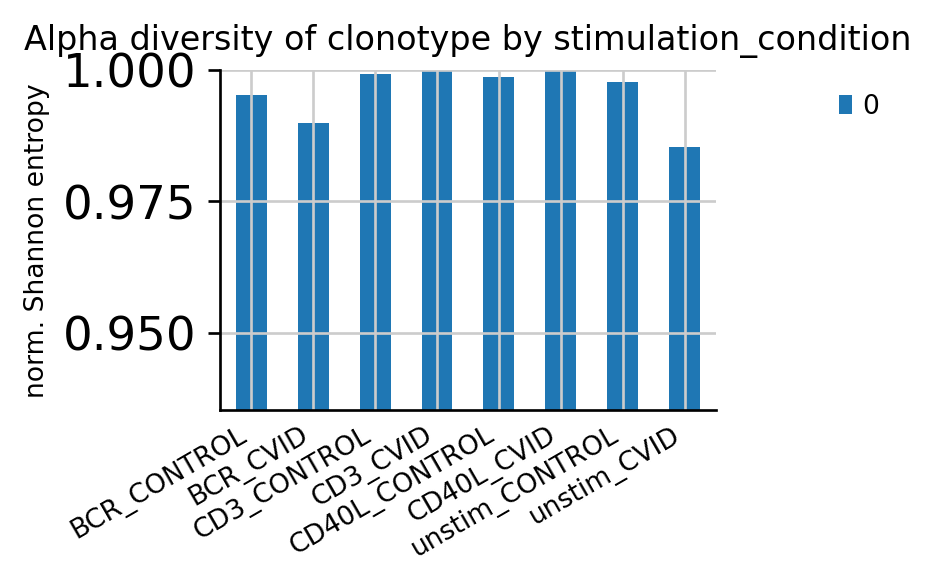

In [76]:
ax = ir.pl.alpha_diversity(adata_twins, groupby="stimulation_condition")


In [10]:
# another metric that we could compare: the number of expanded clonotypes
len(np.unique(adata[(adata.obs['expanded_or_not_2_or_more'] == 'True')
                   & (adata.obs['CVID_status'] == 'CVID')].obs['clonotype']))

/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['distances'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_nt_identity']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should no

1582

In [11]:
# another metric that we could compare: the number of expanded clonotypes
len(np.unique(adata[(adata.obs['expanded_or_not_2_or_more'] == 'True')
                   & (adata.obs['CVID_status'] == 'CONTROL')].obs['clonotype']))

751

In [12]:
# another metric that we could compare: the number of expanded clonotypes
len(np.unique(adata_twins[(adata_twins.obs['expanded_or_not_2_or_more'] == 'True')
                   & (adata_twins.obs['CVID_status'] == 'CVID')].obs['clonotype']))

/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['connectivities'] that happens to be dimensioned at n_obs×n_obs (5246×5246).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['distances'] that happens to be dimensioned at n_obs×n_obs (5246×5246).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_nt_identity']['connectivities'] that happens to be dimensioned at n_obs×n_obs (5246×5246).

These matrices should now be s

67

In [13]:
# another metric that we could compare: the number of expanded clonotypes
len(np.unique(adata_twins[(adata_twins.obs['expanded_or_not_2_or_more'] == 'True')
                   & (adata_twins.obs['CVID_status'] == 'CONTROL')].obs['clonotype']))

69

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt

In [33]:
adata

AnnData object with n_obs × n_vars = 77696 × 2696
    obs: 'n_genes', 'stimulation', 'sample', 'cell_id', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type_final', 'S_score', 'G2M_score', 'phase', 'louvain', 'n_counts_protein', 'n_counts_protein_lognorm', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', '

/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_aa_alignment']['distances'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:215: FutureWarning: During AnnData slicing, found matrix at .uns['ir_neighbors_nt_identity']['connectivities'] that happens to be dimensioned at n_obs×n_obs (77696×77696).

These matrices should no

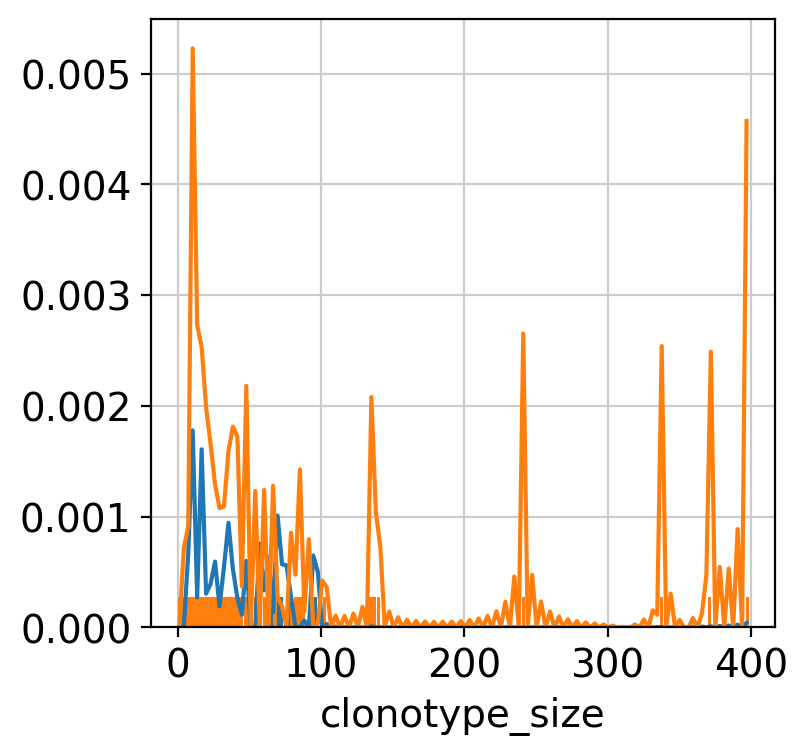

In [34]:
sns.distplot(adata[adata.obs['CVID_status'] == 'CONTROL'].obs['clonotype_size'], hist=False, rug=True) # blue
sns.distplot(adata[adata.obs['CVID_status'] == 'CVID'].obs['clonotype_size'], hist=False, rug=True) # orange

plt.show()

In [ ]:
sns.distplot(adata_twins[adata_twins.obs['CVID_status'] == 'CONTROL'].obs['clonotype_size'], hist=False, rug=True) # blue
sns.distplot(adata_twins[adata_twins.obs['CVID_status'] == 'CVID'].obs['clonotype_size'], hist=False, rug=True) # orange

plt.show()

## Clonotype abundance


In [87]:
adata.obs['donor']

AAACCTGCAGATGGGT-1        CONTROL4
AAACCTGGTAGCGATG-1    CONTROL_twin
AAACCTGGTTAGATGA-1        CONTROL4
AAACGGGAGGATTCGG-1           CVID3
AAACGGGGTGCGCTTG-1           CVID3
                          ...     
TTTGGTTAGGTAAACT-1        CONTROL8
TTTGGTTTCTACCTGC-1          CVID36
TTTGTCAAGAAACCTA-1        CONTROL7
TTTGTCACACAGCGTC-1          CVID37
TTTGTCAGTAGTACCT-1        CONTROL7
Name: donor, Length: 18069, dtype: category
Categories (21, object): ['CONTROL1', 'CONTROL2', 'CONTROL3', 'CONTROL4', ..., 'CVID34', 'CVID36', 'CVID37', 'CVID_twin']

<AxesSubplot:title={'center':'Number of cells in CVID_status by donor'}, xlabel='CVID_status', ylabel='Number of cells'>

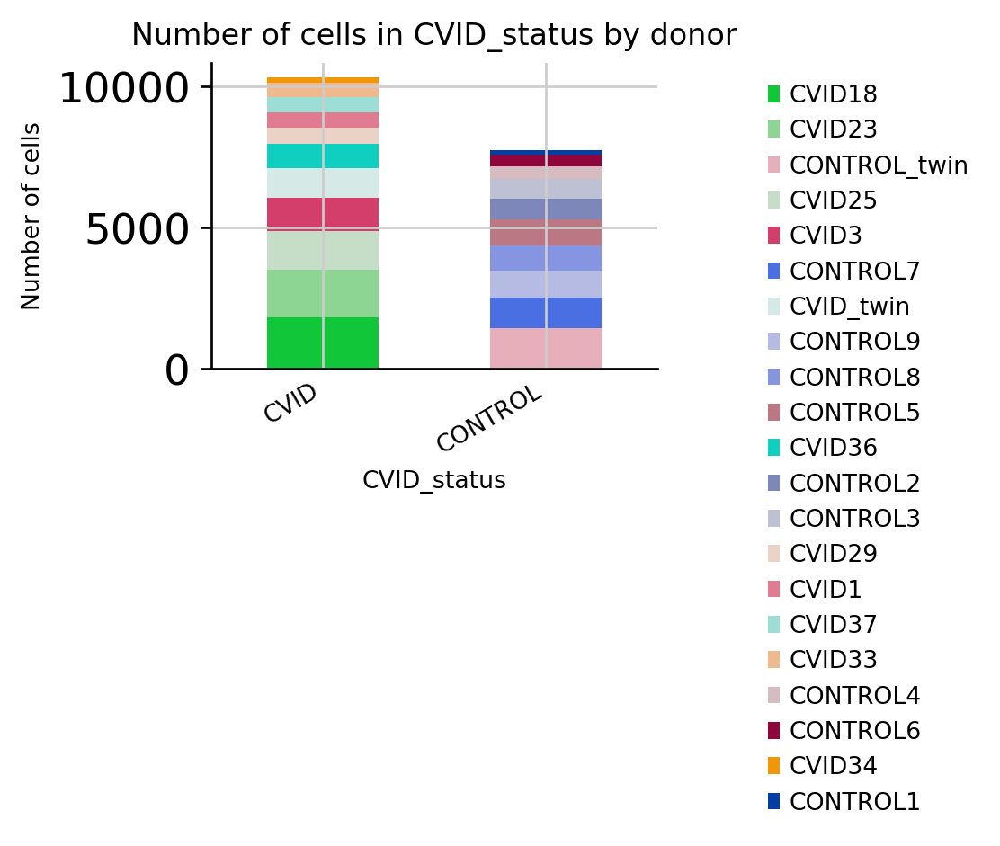

In [91]:
ir.pl.group_abundance(adata, groupby="CVID_status", target_col="donor", max_cols=20)


<AxesSubplot:title={'center':'Fraction of CVID_status in each clonotype'}, xlabel='clonotype', ylabel='Fraction of cells in sample'>

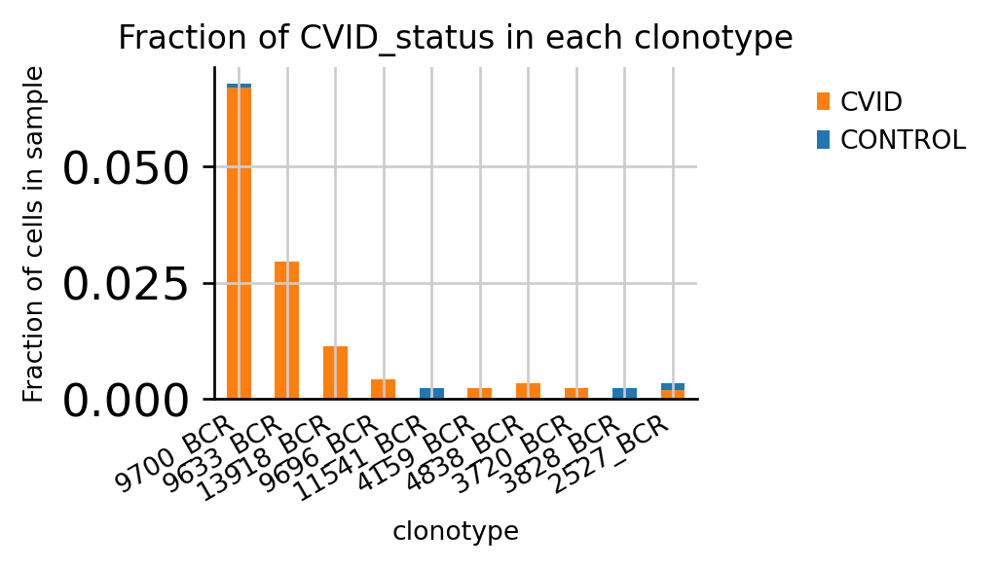

In [92]:
ir.pl.group_abundance(
    adata, groupby="clonotype", target_col="CVID_status", max_cols=10, normalize="sample"
)

# Gene usage


<AxesSubplot:title={'center':'Fraction of CVID_status in each IR_VJ_1_v_gene'}, xlabel='IR_VJ_1_v_gene', ylabel='Fraction of cells in CVID_status'>

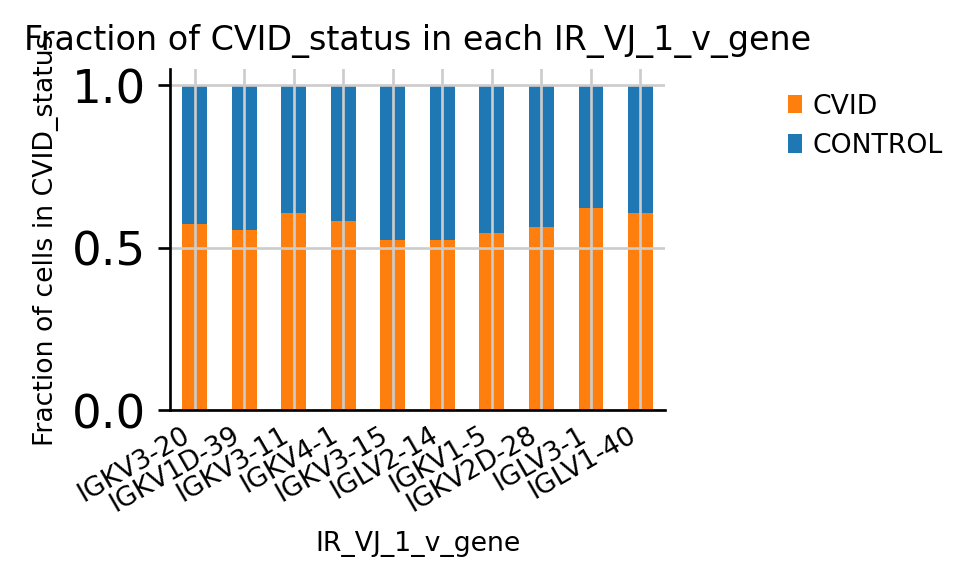

In [95]:
ir.pl.group_abundance(
    adata, groupby="IR_VJ_1_v_gene", target_col="CVID_status", normalize=True, max_cols=10
)

In [97]:
ir.pl.group_abundance(
    adata[
        adata.obs["IR_VDJ_1_v_gene"].isin(
            ["TRBV20-1", "TRBV7-2", "TRBV28", "TRBV5-1", "TRBV7-9"]
        ),
        :,
    ],
    groupby="cluster",
    target_col="IR_VDJ_1_v_gene",
    normalize=True,
)

ValueError: cannot call `vectorize` on size 0 inputs unless `otypes` is set

<AxesSubplot:>

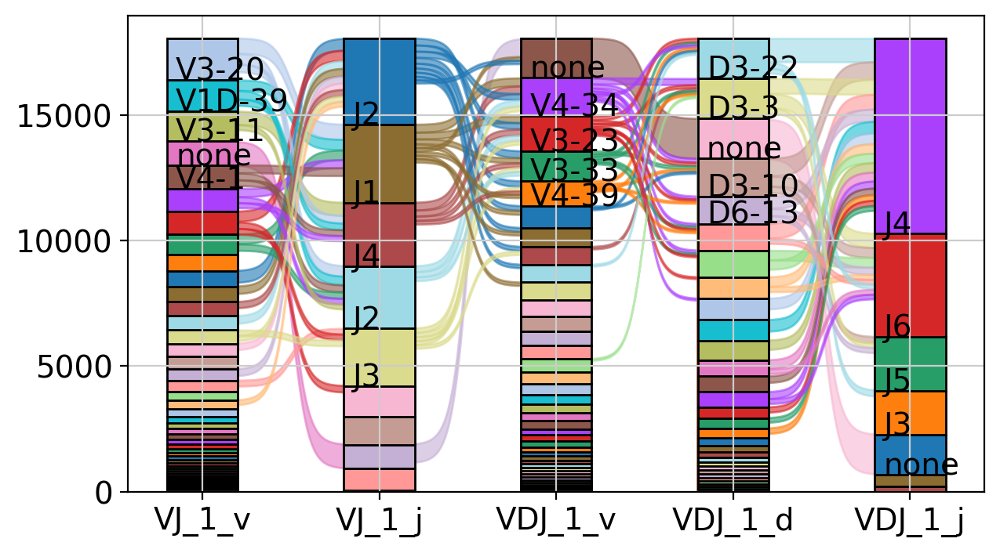

In [98]:
ir.pl.vdj_usage(adata, full_combination=False, max_segments=None, max_ribbons=30)


In [99]:
df, dst, lk = ir.tl.repertoire_overlap(adata, "sample", inplace=False)
df.head()

clonotype,0_BCR,1_BCR,2_BCR,3_BCR,4_BCR,5_BCR,6_BCR,7_BCR,8_BCR,9_BCR,...,17132_BCR,17133_BCR,17134_BCR,17135_BCR,17136_BCR,17137_BCR,17138_BCR,17139_BCR,17140_BCR,17141_BCR
sample,,,,,,,,,,,,,,,,,,,,,
35008_CV005_RV9039258_and_35008_CV005_RV9039282,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35008_CV005_RV9039259_and_35008_CV005_RV9039283,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35008_CV005_RV9039260_and_35008_CV005_RV9039284,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35008_CV005_RV9039261_and_35008_CV005_RV9039285,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35008_CV005_RV9039262_and_35008_CV005_RV9039286,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


/opt/conda/lib/python3.8/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


ValueError: cannot reshape array of size 104 into shape (2,80)

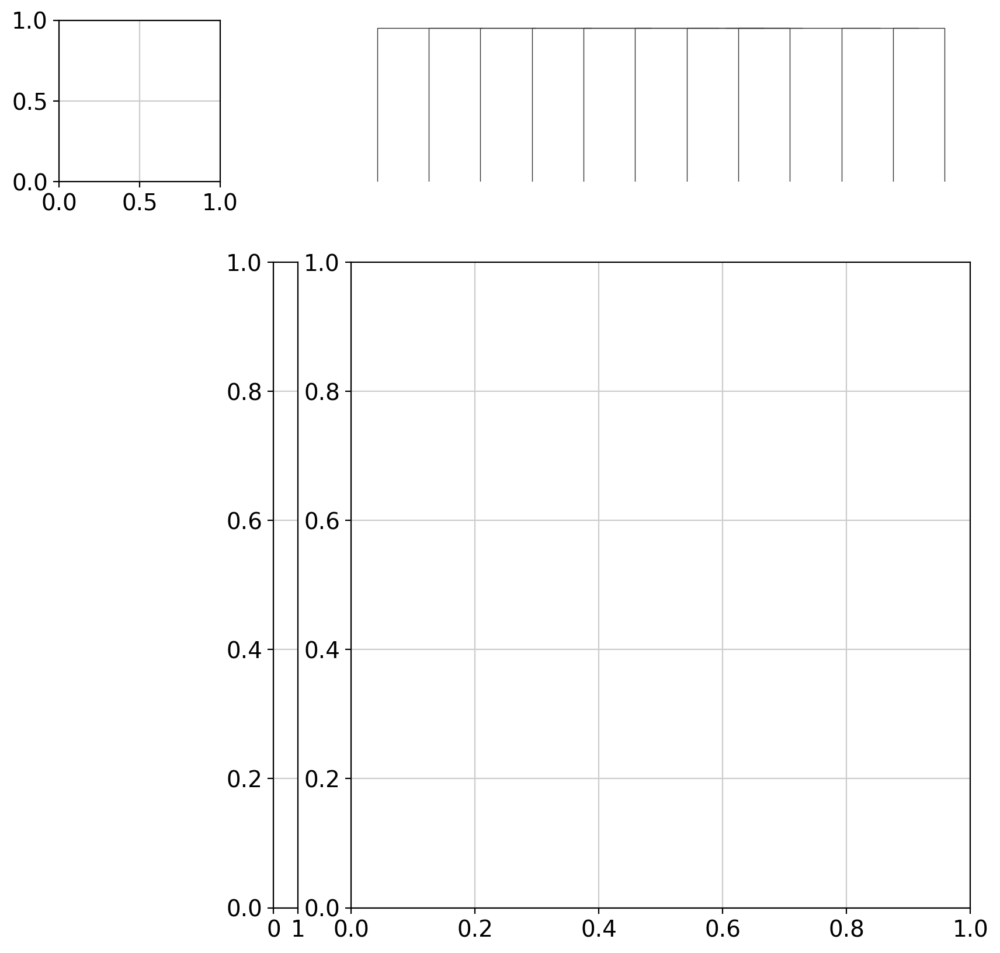

In [101]:
ir.pl.repertoire_overlap(adata, "sample", heatmap_cats=["donor", "CVID_status"])


In [103]:
freq, stat = ir.tl.clonotype_imbalance(
    adata,
    replicate_col="sample",
    groupby="CVID_status",
    case_label="CVID",
    control_label="CONTROL",
    inplace=False,
)
top_differential_clonotypes = stat["clonotype"].tolist()[:5]

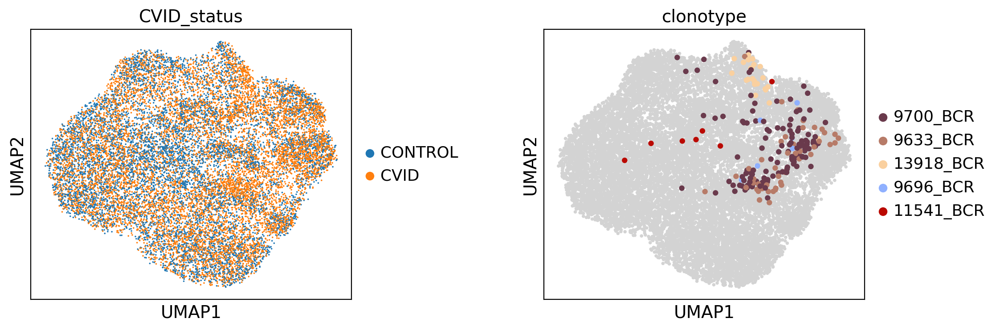

In [105]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), gridspec_kw={"wspace": 0.6})
sc.pl.umap(adata, color="CVID_status", ax=ax1, show=False)
sc.pl.umap(
    adata,
    color="clonotype",
    groups=top_differential_clonotypes,
    ax=ax2,
    # increase size of highlighted dots
    size=[
        80 if c in top_differential_clonotypes else 30 for c in adata.obs["clonotype"]
    ],
)

No handles with labels found to put in legend.


<AxesSubplot:title={'center':'Repertoire overlap between CVID and CONTROL'}, xlabel='Clonotype size in CVID', ylabel='Clonotype size in CONTROL'>

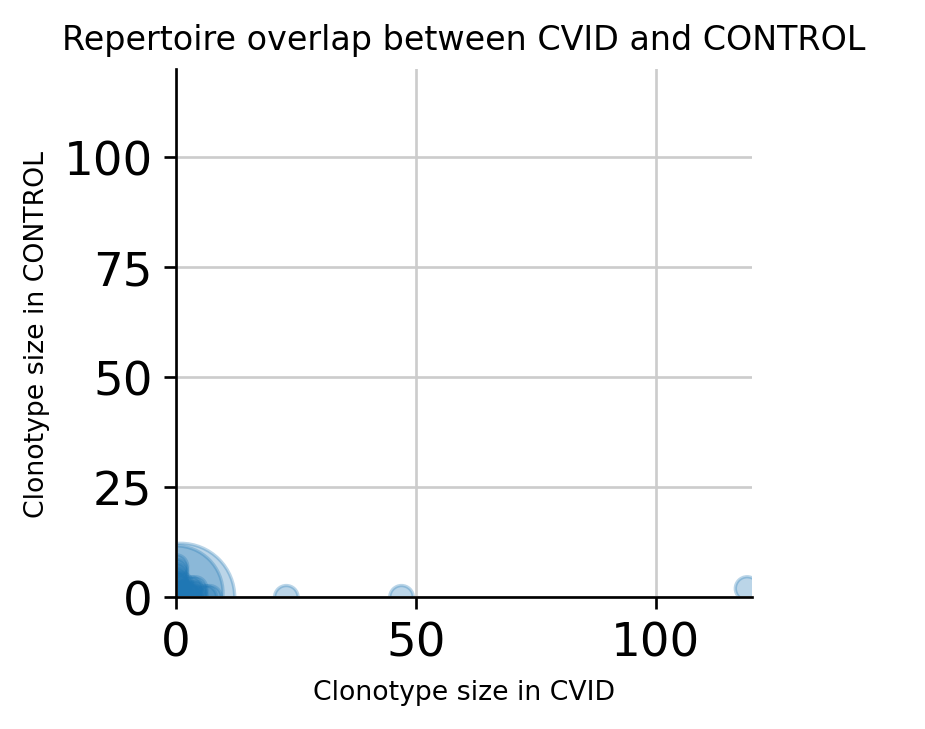

In [108]:
ir.tl.repertoire_overlap(adata, "CVID_status")
ir.pl.repertoire_overlap(
    adata, "CVID_status", pair_to_plot=["CVID", "CONTROL"], fig_kws={"dpi": 120}
)

In [112]:
# saving all calculated BCR information / metrics into a csv file
BCR_info_B_cells = pd.DataFrame(adata.obs.loc[:,['IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 
                 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 
                 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 
                 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 
                 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', 
                 'IR_VJ_2_v_gene', 'IR_VDJ_1_v_gene', 'IR_VDJ_2_v_gene', 'IR_VJ_1_d_gene', 'IR_VJ_2_d_gene', 
                 'IR_VDJ_1_d_gene', 'IR_VDJ_2_d_gene', 'IR_VJ_1_j_gene', 'IR_VJ_2_j_gene', 'IR_VDJ_1_j_gene', 
                 'IR_VDJ_2_j_gene', 'IR_VJ_1_c_gene', 'IR_VJ_2_c_gene', 'IR_VDJ_1_c_gene', 'IR_VDJ_2_c_gene', 
                 'IR_VJ_1_junction_ins', 'IR_VJ_2_junction_ins', 'IR_VDJ_1_junction_ins', 'IR_VDJ_2_junction_ins', 
                 'has_ir', 'multi_chain', 'receptor_type', 'receptor_subtype', 'chain_pairing', 'clonotype', 
                 'clonotype_size', 'ct_cluster_aa_alignment', 'ct_cluster_aa_alignment_size', 
                 'ct_cluster_aa_alignment_same_v', 'ct_cluster_aa_alignment_same_v_size', 'clonal_expansion']])

BCR_info_B_cells.to_csv(save_path + '20210106_B_cells_BCR_metrics_scirpy.csv')

In [113]:
BCR_info_B_cells

,IR_VJ_1_locus,IR_VJ_2_locus,IR_VDJ_1_locus,IR_VDJ_2_locus,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,IR_VJ_1_cdr3_nt,IR_VJ_2_cdr3_nt,...,receptor_type,receptor_subtype,chain_pairing,clonotype,clonotype_size,ct_cluster_aa_alignment,ct_cluster_aa_alignment_size,ct_cluster_aa_alignment_same_v,ct_cluster_aa_alignment_same_v_size,clonal_expansion
AAACCTGCAGATGGGT-1,IGL,nan,nan,nan,CQSADSSGTYRSF,None,None,None,TGTCAATCAGCAGACAGCAGTGGTACTTATCGGAGCTTC,None,...,BCR,IGH+IGL,orphan VJ,0_BCR,1,0,15,0_IGLV3-25_nan_BCR,14,1
AAACCTGGTAGCGATG-1,IGL,nan,IGH,nan,CYSTDSSGNQGVF,None,CAKLAVAGDFDYW,None,TGTTACTCAACAGACAGCAGTGGTAATCAGGGGGTATTC,None,...,BCR,IGH+IGL,single pair,1_BCR,1,1,1,1_IGLV3-10_IGHV3-30_BCR,1,1
AAACCTGGTTAGATGA-1,IGL,nan,IGH,nan,CSSYTSSSTWVF,None,CARVYRGALWFDPW,None,TGCAGCTCATATACAAGCAGCAGCACTTGGGTGTTC,None,...,BCR,IGH+IGL,single pair,2_BCR,1,2,1,2_IGLV2-14_IGHV1-18_BCR,1,1
AAACGGGAGGATTCGG-1,IGL,nan,IGH,nan,CSSYTSSSAWVF,None,CARRGVEGYYYYMDVW,None,TGCAGCTCATATACAAGCAGCAGCGCTTGGGTGTTC,None,...,BCR,IGH+IGL,single pair,3_BCR,1,3,1,3_IGLV2-14_IGHV5-51_BCR,1,1
AAACGGGGTGCGCTTG-1,IGL,nan,IGH,nan,CQSYDSSLSGSVVF,None,CARVGDSSGYYSPDAFDIW,None,TGCCAGTCCTATGACAGCAGCCTGAGTGGTTCTGTGGTATTC,None,...,BCR,IGH+IGL,single pair,4_BCR,1,4,1,4_IGLV1-40_IGHV1-2_BCR,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGGTAAACT-1,IGL,nan,IGH,nan,CQAWDSSTVVF,None,CARDLSDYDFWSGPRGYYGMDVW,None,TGTCAGGCGTGGGACAGCAGCACTGTGGTATTC,None,...,BCR,IGH+IGL,single pair,17137_BCR,1,16624,1,16624_IGLV3-1_IGHV3-74_BCR,1,1
TTTGGTTTCTACCTGC-1,IGK,nan,IGH,nan,CQQSYSTPTF,None,CARVDTAMVPYFDYW,None,TGTCAACAGAGTTACAGTACCCCTACTTTT,None,...,BCR,IGH+IGK,single pair,17138_BCR,1,16625,1,16625_IGKV1D-39_IGHV4-31_BCR,1,1
TTTGTCAAGAAACCTA-1,IGL,IGK,IGH,nan,CSSYTSSSTLEVF,CQQRSDWPLTF,CARRKGGRVDYW,None,TGCAGCTCATATACAAGCAGCAGCACTCTCGAGGTCTTC,TGTCAGCAGCGTAGCGACTGGCCGCTCACTTTC,...,BCR,ambiguous,ambiguous,17139_BCR,1,16626,1,16626_IGLV2-14_IGHV3-66_BCR,1,1
TTTGTCACACAGCGTC-1,IGL,nan,IGH,nan,CGTWDSSLSAGVF,None,CASSGYYYRFFDYW,None,TGCGGAACATGGGATAGCAGCCTGAGTGCTGGGGTATTC,None,...,BCR,IGH+IGL,single pair,17140_BCR,1,16627,1,16627_IGLV1-51_IGHV1-69_BCR,1,1
